In [1]:
# imports
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import random

plt.style.use("ggplot")


In [2]:
# Load labels
labels_path = "training_solutions_rev1.csv"
df = pd.read_csv(labels_path)
df.head()


,GalaxyID,Class1.1,Class1.2,Class1.3,Class2.1,Class2.2,Class3.1,Class3.2,Class4.1,Class4.2,...,Class9.3,Class10.1,Class10.2,Class10.3,Class11.1,Class11.2,Class11.3,Class11.4,Class11.5,Class11.6
0,100008,0.383147,0.616853,0.000000,0.000000,0.616853,0.038452,0.578401,0.418398,0.198455,...,0.000000,0.279952,0.138445,0.000000,0.000000,0.092886,0.0,0.0,0.0,0.325512
1,100023,0.327001,0.663777,0.009222,0.031178,0.632599,0.467370,0.165229,0.591328,0.041271,...,0.018764,0.000000,0.131378,0.459950,0.000000,0.591328,0.0,0.0,0.0,0.000000
2,100053,0.765717,0.177352,0.056931,0.000000,0.177352,0.000000,0.177352,0.000000,0.177352,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000
3,100078,0.693377,0.238564,0.068059,0.000000,0.238564,0.109493,0.129071,0.189098,0.049466,...,0.000000,0.094549,0.000000,0.094549,0.189098,0.000000,0.0,0.0,0.0,0.000000
4,100090,0.933839,0.000000,0.066161,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61578 entries, 0 to 61577
Data columns (total 38 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   GalaxyID   61578 non-null  int64  
 1   Class1.1   61578 non-null  float64
 2   Class1.2   61578 non-null  float64
 3   Class1.3   61578 non-null  float64
 4   Class2.1   61578 non-null  float64
 5   Class2.2   61578 non-null  float64
 6   Class3.1   61578 non-null  float64
 7   Class3.2   61578 non-null  float64
 8   Class4.1   61578 non-null  float64
 9   Class4.2   61578 non-null  float64
 10  Class5.1   61578 non-null  float64
 11  Class5.2   61578 non-null  float64
 12  Class5.3   61578 non-null  float64
 13  Class5.4   61578 non-null  float64
 14  Class6.1   61578 non-null  float64
 15  Class6.2   61578 non-null  float64
 16  Class7.1   61578 non-null  float64
 17  Class7.2   61578 non-null  float64
 18  Class7.3   61578 non-null  float64
 19  Class8.1   61578 non-null  float64
 20  Class8

In [14]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
GalaxyID,61578.0,550179.708337,2.587241e+05,100008.000000,327874.250000,551933.000000,773232.000000,999967.000000
Class1.1,61578.0,0.432526,2.835171e-01,0.000000,0.175812,0.416994,0.679182,1.000000
Class1.2,61578.0,0.542261,2.964287e-01,0.000000,0.280862,0.558754,0.811339,1.000000
Class1.3,61578.0,0.025213,3.796681e-02,0.000000,0.000000,0.014870,0.034325,0.935147
Class2.1,61578.0,0.106408,2.125053e-01,0.000000,0.000000,0.000000,0.085161,1.000000
Class2.2,61578.0,0.435854,3.018671e-01,0.000000,0.168490,0.394850,0.694615,1.000000
Class3.1,61578.0,0.102526,1.773008e-01,0.000000,0.000000,0.000000,0.134555,1.000000
Class3.2,61578.0,0.333328,2.476747e-01,0.000000,0.122592,0.289248,0.516800,1.000000
Class4.1,61578.0,0.215629,2.855020e-01,0.000000,0.000000,0.092987,0.330231,1.000000
Class4.2,61578.0,0.220224,1.798348e-01,0.000000,0.072656,0.183640,0.338920,0.957937


In [13]:
df.columns.tolist()


['GalaxyID',
 'Class1.1',
 'Class1.2',
 'Class1.3',
 'Class2.1',
 'Class2.2',
 'Class3.1',
 'Class3.2',
 'Class4.1',
 'Class4.2',
 'Class5.1',
 'Class5.2',
 'Class5.3',
 'Class5.4',
 'Class6.1',
 'Class6.2',
 'Class7.1',
 'Class7.2',
 'Class7.3',
 'Class8.1',
 'Class8.2',
 'Class8.3',
 'Class8.4',
 'Class8.5',
 'Class8.6',
 'Class8.7',
 'Class9.1',
 'Class9.2',
 'Class9.3',
 'Class10.1',
 'Class10.2',
 'Class10.3',
 'Class11.1',
 'Class11.2',
 'Class11.3',
 'Class11.4',
 'Class11.5',
 'Class11.6',
 'sum_class1']

In [15]:
# Helper dictionary for class groups
class_groups = {
    "Class1": ['Class1.1','Class1.2','Class1.3'],
    "Class2": ['Class2.1','Class2.2'],
    "Class3": ['Class3.1','Class3.2'],
    "Class4": ['Class4.1','Class4.2'],
    "Class5": ['Class5.1','Class5.2','Class5.3','Class5.4'],
    "Class6": ['Class6.1','Class6.2'],
    "Class7": ['Class7.1','Class7.2','Class7.3'],
    "Class8": ['Class8.1','Class8.2','Class8.3','Class8.4','Class8.5','Class8.6','Class8.7'],
    "Class9": ['Class9.1','Class9.2','Class9.3'],
    "Class10": ['Class10.1','Class10.2','Class10.3'],
    "Class11": ['Class11.1','Class11.2','Class11.3','Class11.4','Class11.5','Class11.6'],
}


In [18]:
# Probability sum for each class group
sum_stats = {}

for cname, cols in class_groups.items():
    s = df[cols].sum(axis=1)
    sum_stats[cname] = s.describe()

pd.DataFrame(sum_stats).T


,count,mean,std,min,25%,50%,75%,max
Class1,61578.0,1.000000,4.085684e-07,0.999999,1.000000,1.000000,1.000000,1.000001
Class2,61578.0,0.542261,2.964287e-01,0.000000,0.280862,0.558754,0.811339,1.000000
Class3,61578.0,0.435854,3.018671e-01,0.000000,0.168490,0.394850,0.694615,1.000000
Class4,61578.0,0.435854,3.018671e-01,0.000000,0.168490,0.394850,0.694615,1.000000
Class5,61578.0,0.435854,3.018671e-01,0.000000,0.168490,0.394850,0.694614,1.000001
Class6,61578.0,1.000000,0.000000e+00,1.000000,1.000000,1.000000,1.000000,1.000000
Class7,61578.0,0.432526,2.835171e-01,0.000000,0.175812,0.416994,0.679182,1.000001
Class8,61578.0,0.231807,2.273927e-01,0.000000,0.066087,0.149545,0.326944,1.000001
Class9,61578.0,0.106408,2.125053e-01,0.000000,0.000000,0.000000,0.085161,1.000000
Class10,61578.0,0.215629,2.855020e-01,0.000000,0.000000,0.092987,0.330231,1.000001


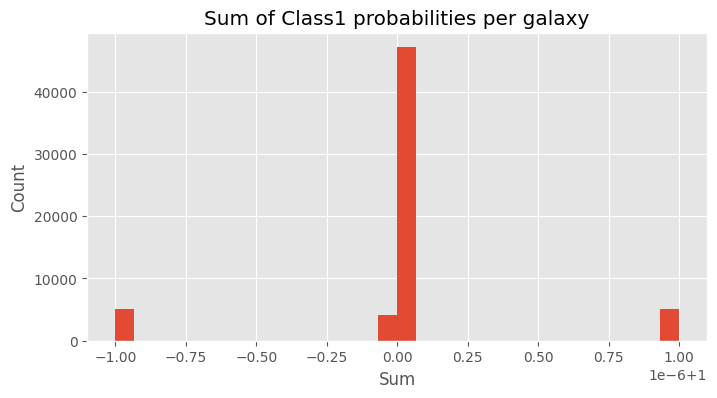

In [20]:
# Visual View of Probability Distributions (Class 1 for sample)
plt.figure(figsize=(8,4))
plt.hist(df[class_groups["Class1"]].sum(axis=1), bins=30)
plt.title("Sum of Class1 probabilities per galaxy")
plt.xlabel("Sum")
plt.ylabel("Count")
plt.show()


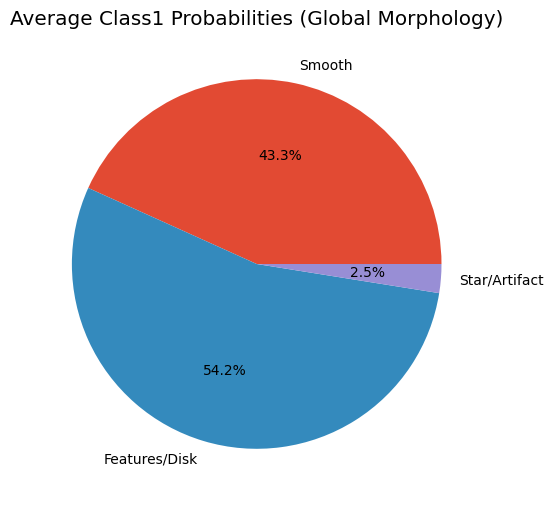

In [24]:
# Composition of Class 1 morphology
class1_means = df[class_groups["Class1"]].mean()
class1_means.index = ["Smooth","Features/Disk","Star/Artifact"]

plt.figure(figsize=(6,6))
class1_means.plot(kind="pie", autopct="%1.1f%%", ylabel="")
plt.title("Average Class1 Probabilities (Global Morphology)")
plt.show()


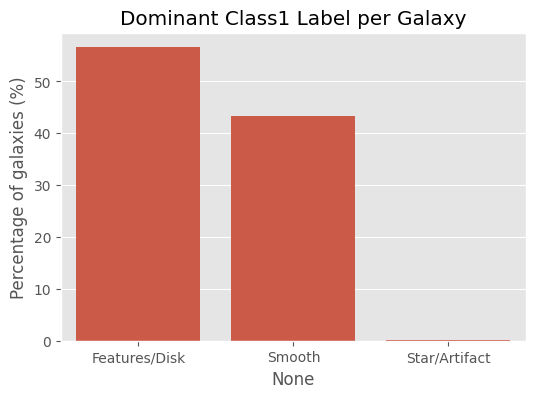

Features/Disk    56.555913
Smooth           43.348274
Star/Artifact     0.095813
Name: proportion, dtype: float64

In [26]:
# Class 1 dominant label per galaxy
class1_argmax = df[class_groups["Class1"]].idxmax(axis=1)

mapping_c1 = {
    'Class1.1': 'Smooth',
    'Class1.2': 'Features/Disk',
    'Class1.3': 'Star/Artifact'
}
dominant_class1 = class1_argmax.map(mapping_c1).value_counts(normalize=True) * 100

plt.figure(figsize=(6,4))
sns.barplot(x=dominant_class1.index, y=dominant_class1.values)
plt.ylabel("Percentage of galaxies (%)")
plt.title("Dominant Class1 Label per Galaxy")
plt.show()

dominant_class1


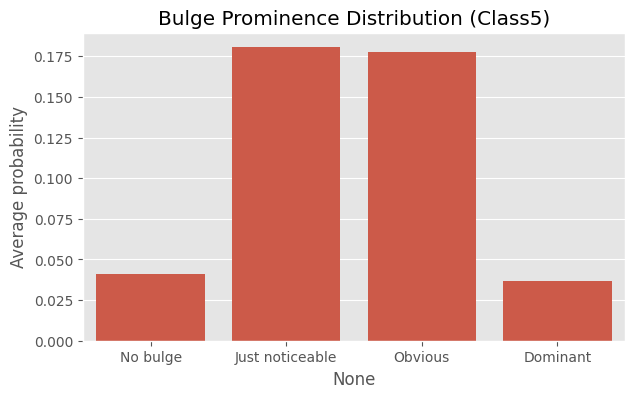

In [27]:
# CLass 5 Bulge Prominence
c5_means = df[class_groups["Class5"]].mean()
c5_means.index = ["No bulge","Just noticeable","Obvious","Dominant"]

plt.figure(figsize=(7,4))
sns.barplot(x=c5_means.index, y=c5_means.values)
plt.ylabel("Average probability")
plt.title("Bulge Prominence Distribution (Class5)")
plt.show()


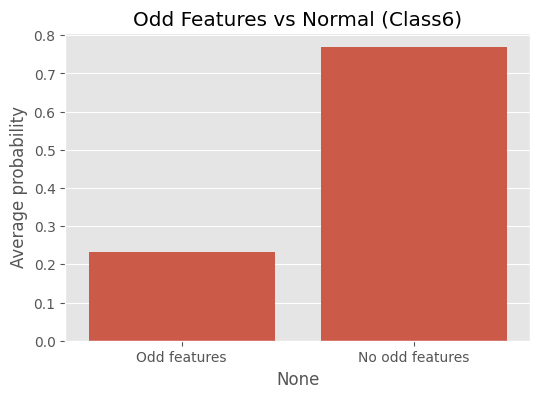

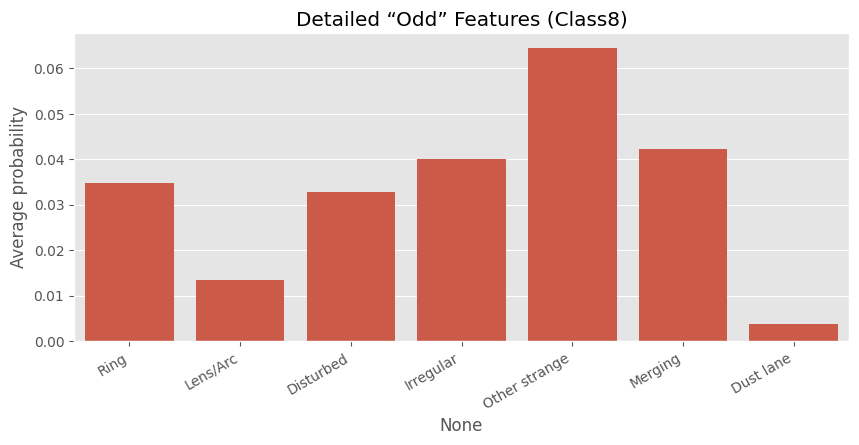

In [29]:
# Odd features (Class6) and ring/merger etc. (Class8)
c6_means = df[class_groups["Class6"]].mean()
c6_means.index = ["Odd features","No odd features"]

plt.figure(figsize=(6,4))
sns.barplot(x=c6_means.index, y=c6_means.values)
plt.title("Odd Features vs Normal (Class6)")
plt.ylabel("Average probability")
plt.show()

c8_means = df[class_groups["Class8"]].mean()
c8_means.index = [
    "Ring","Lens/Arc","Disturbed","Irregular",
    "Other strange","Merging","Dust lane"
]

plt.figure(figsize=(10,4))
sns.barplot(x=c8_means.index, y=c8_means.values)
plt.xticks(rotation=30, ha="right")
plt.ylabel("Average probability")
plt.title("Detailed “Odd” Features (Class8)")
plt.show()


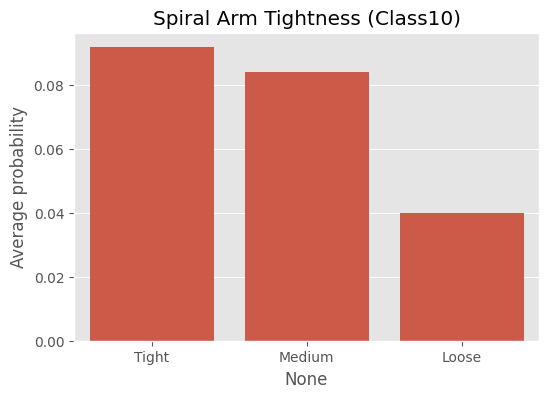

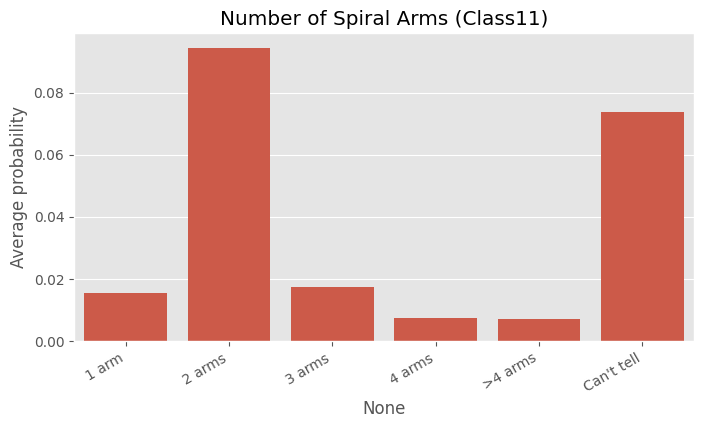

In [31]:
# Spiral arm tightness & count (Class10 & Class11)
c10_means = df[class_groups["Class10"]].mean()
c10_means.index = ["Tight","Medium","Loose"]

plt.figure(figsize=(6,4))
sns.barplot(x=c10_means.index, y=c10_means.values)
plt.title("Spiral Arm Tightness (Class10)")
plt.ylabel("Average probability")
plt.show()

c11_means = df[class_groups["Class11"]].mean()
c11_means.index = ["1 arm","2 arms","3 arms","4 arms",">4 arms","Can't tell"]

plt.figure(figsize=(8,4))
sns.barplot(x=c11_means.index, y=c11_means.values)
plt.title("Number of Spiral Arms (Class11)")
plt.ylabel("Average probability")
plt.xticks(rotation=30, ha="right")
plt.show()


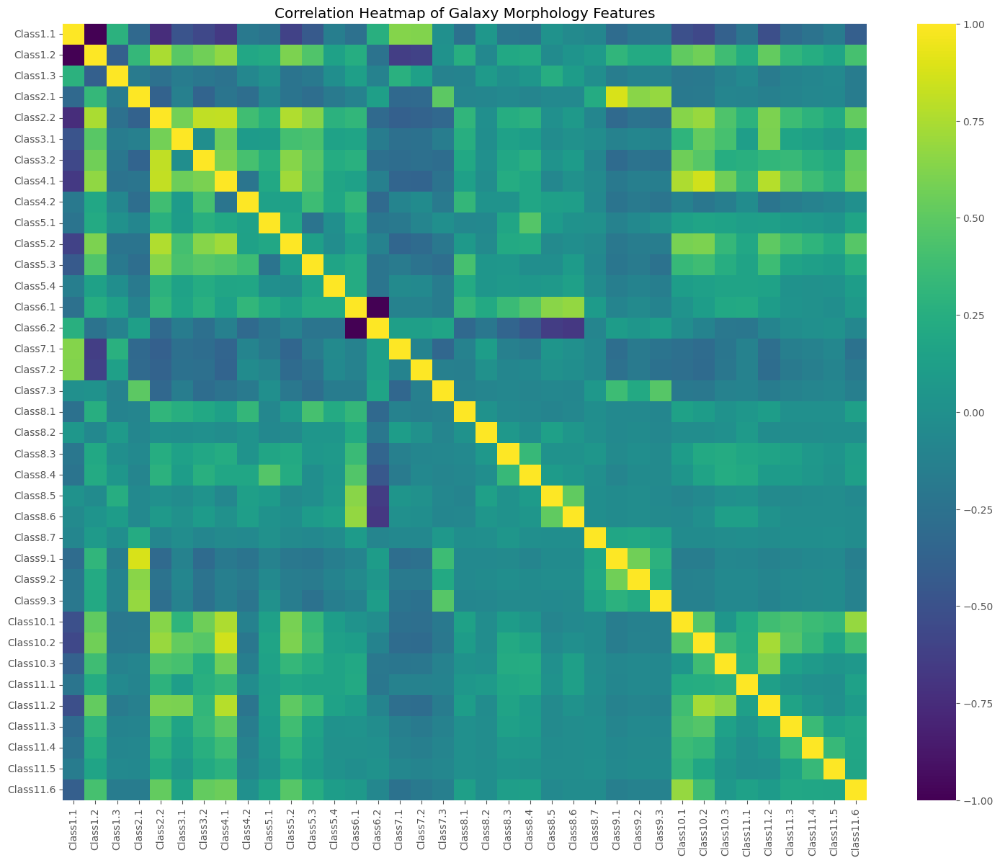

In [32]:
# Correlation between different features
plt.figure(figsize=(18,14))
sns.heatmap(df[[c for c in df.columns if c.startswith("Class") and c != "sum_class1"]].corr(),
            cmap="viridis")
plt.title("Correlation Heatmap of Galaxy Morphology Features")
plt.show()


In [34]:
image_dir = "images_training_rev1"

In [35]:
def get_image_path(galaxy_id, image_dir=image_dir):
    return os.path.join(image_dir, f"{int(galaxy_id)}.jpg")

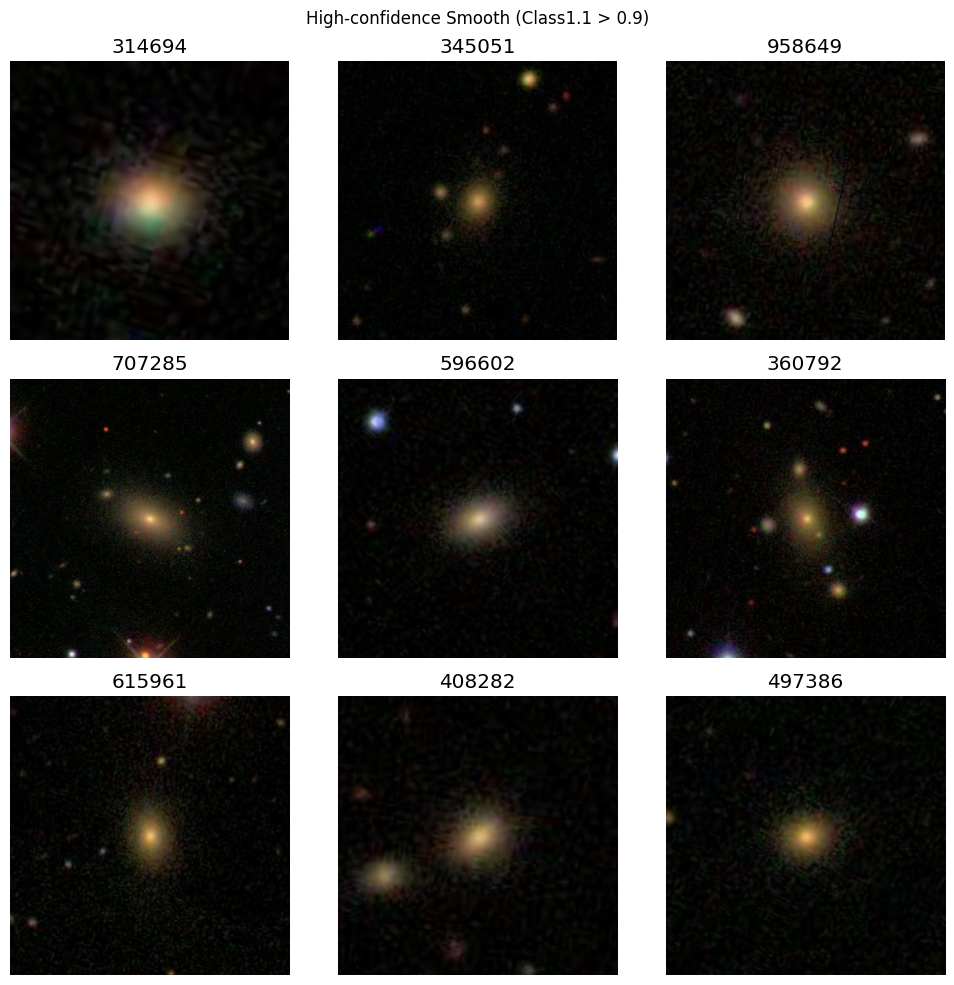

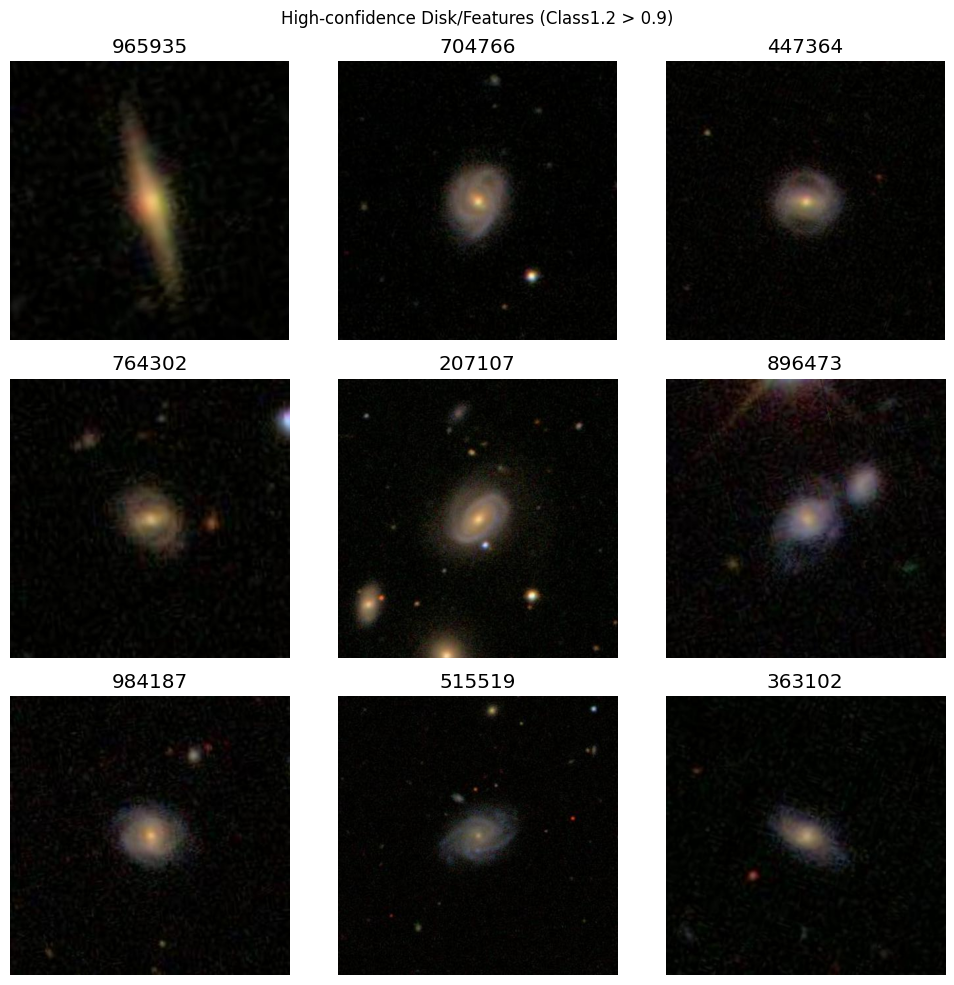

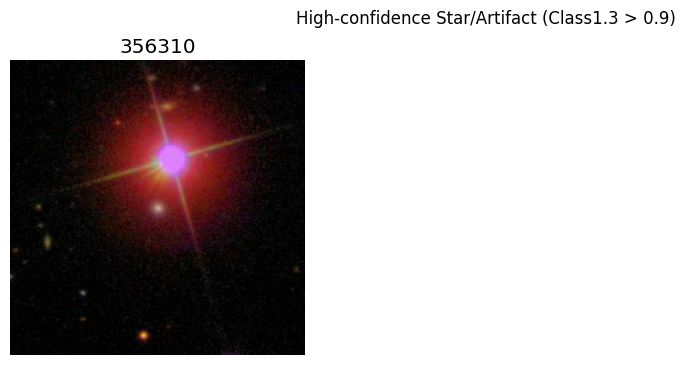

In [36]:
# High-confidence smooth vs disk vs artifact
def show_examples(mask, title, n=9):
    sample = df[mask].sample(min(n, mask.sum()), random_state=42)
    
    plt.figure(figsize=(10,10))
    for i, (_, row) in enumerate(sample.iterrows()):
        galaxy_id = row["GalaxyID"]
        img_path = get_image_path(galaxy_id)
        img = Image.open(img_path)
        plt.subplot(3,3,i+1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(int(galaxy_id))
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

# Smooth (Class1.1 > 0.9)
show_examples(df["Class1.1"] > 0.9, "High-confidence Smooth (Class1.1 > 0.9)")

# Disk/Features (Class1.2 > 0.9)
show_examples(df["Class1.2"] > 0.9, "High-confidence Disk/Features (Class1.2 > 0.9)")

# Star/Artifact (Class1.3 > 0.9)
show_examples(df["Class1.3"] > 0.9, "High-confidence Star/Artifact (Class1.3 > 0.9)")


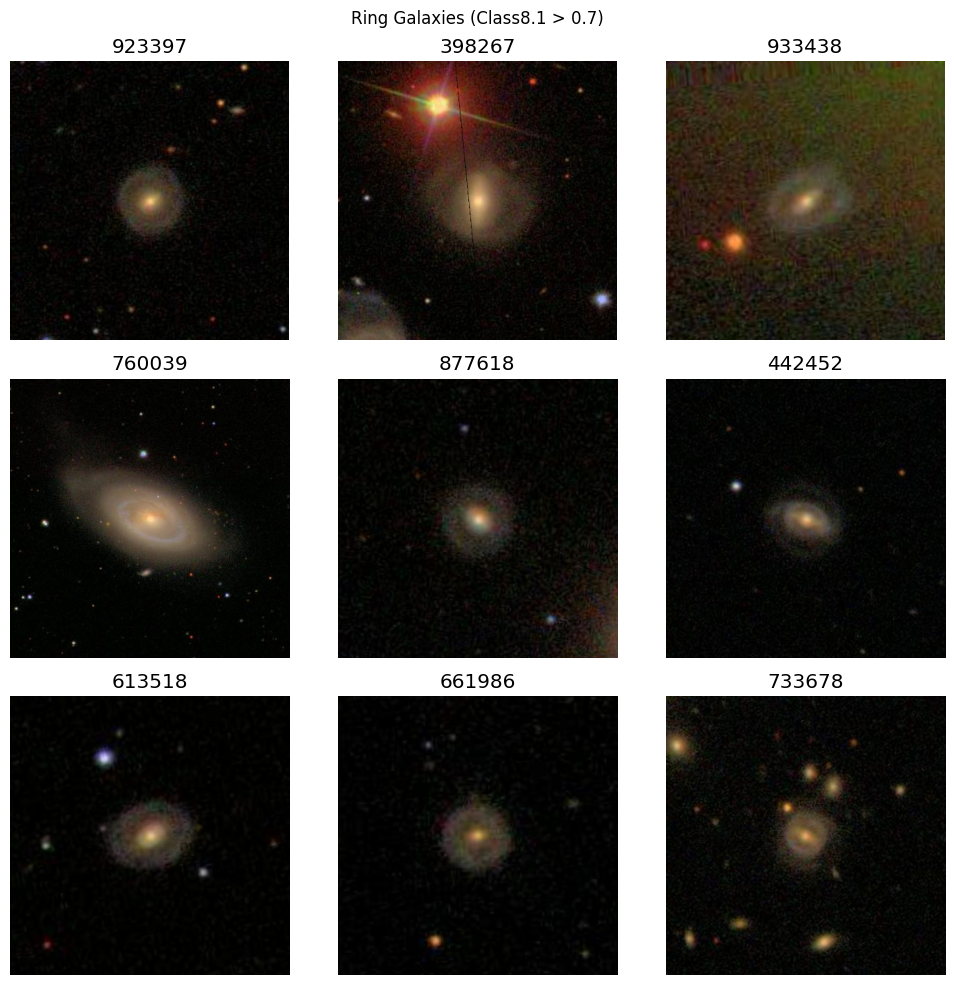

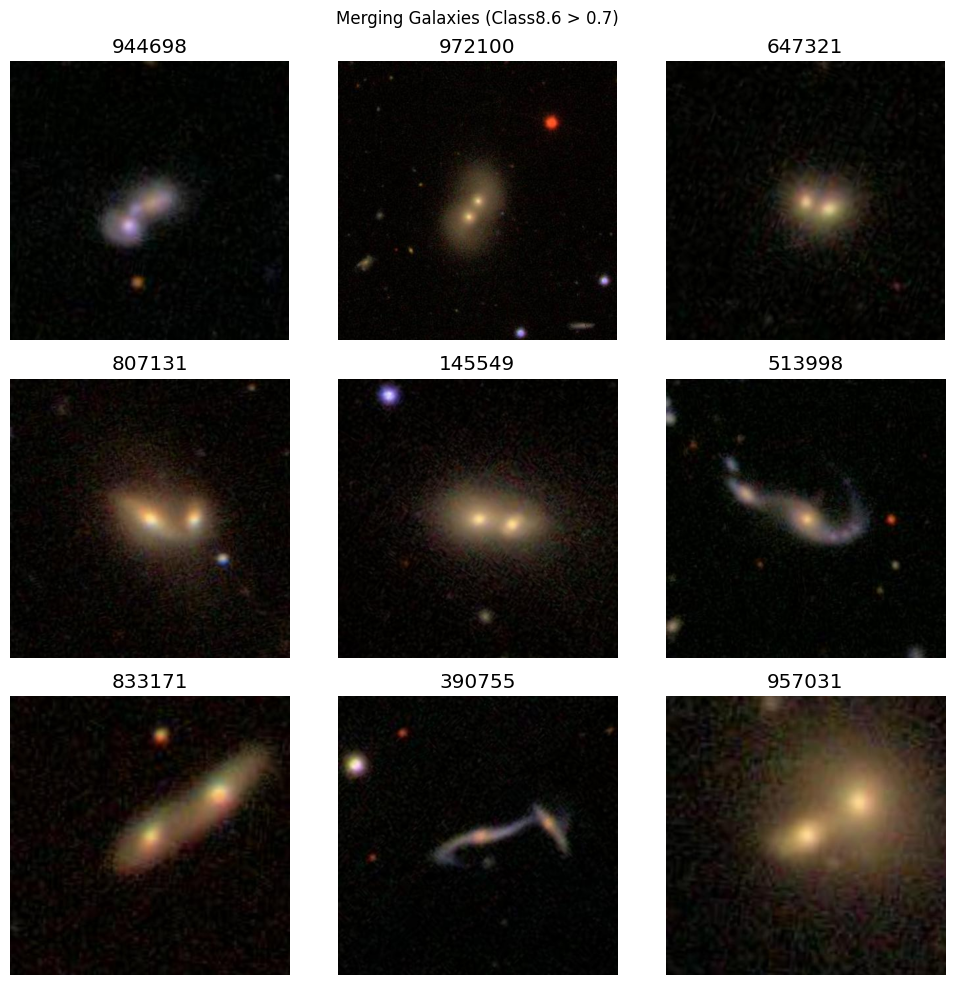

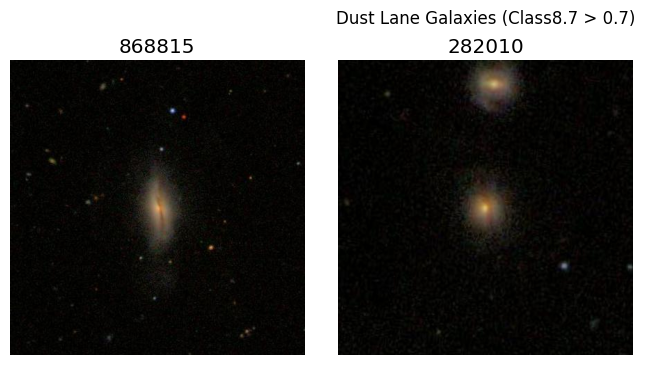

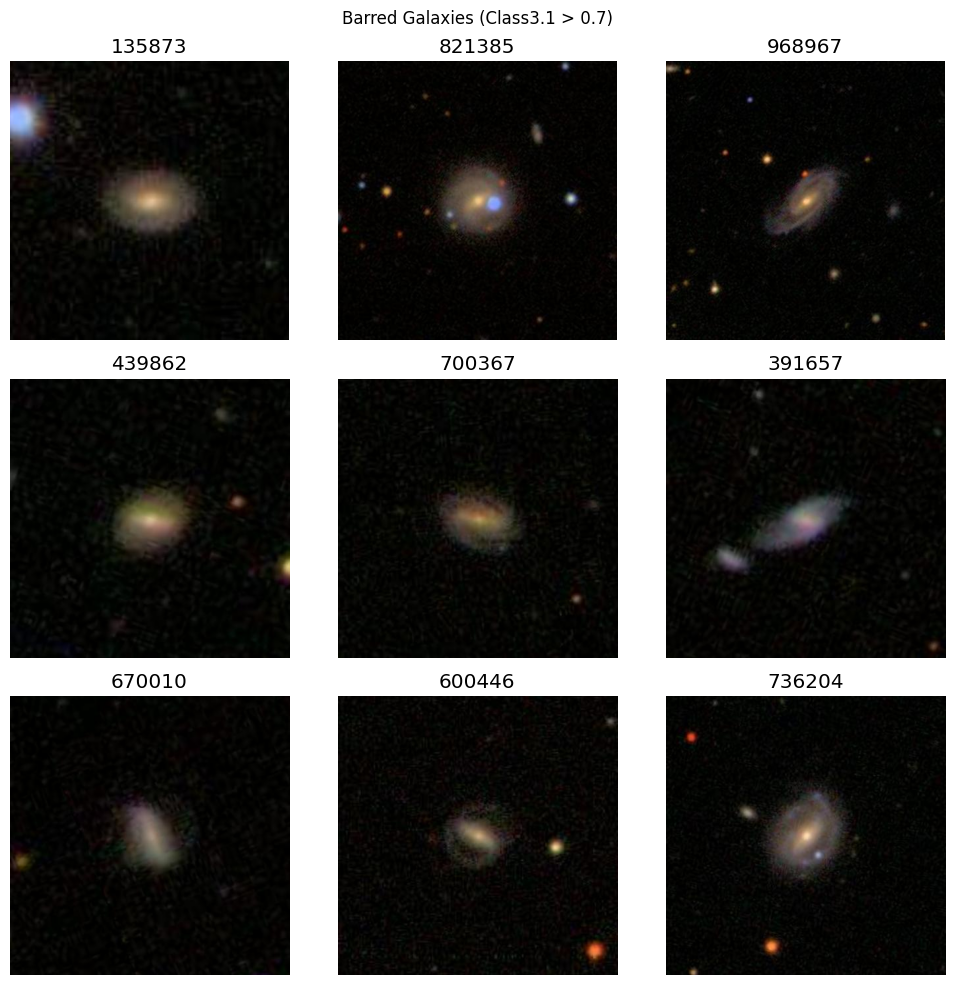

In [37]:
# Examples of specific features
# Ring (Class8.1)
show_examples(df["Class8.1"] > 0.7, "Ring Galaxies (Class8.1 > 0.7)")

# Merging (Class8.6)
show_examples(df["Class8.6"] > 0.7, "Merging Galaxies (Class8.6 > 0.7)")

# Dust Lane (Class8.7)
show_examples(df["Class8.7"] > 0.7, "Dust Lane Galaxies (Class8.7 > 0.7)")

# Bar (Class3.1)
show_examples(df["Class3.1"] > 0.7, "Barred Galaxies (Class3.1 > 0.7)")


# Deeper Analysis

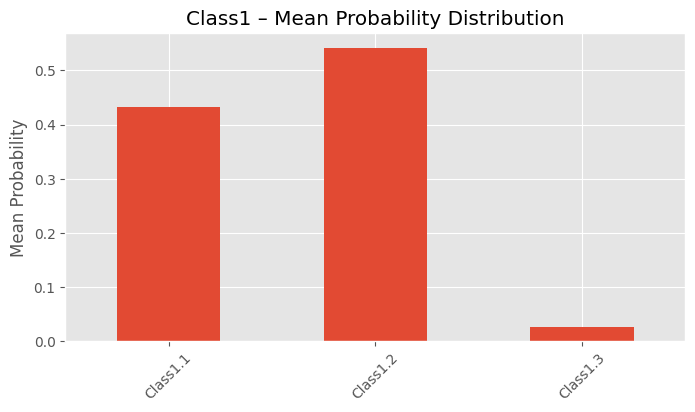

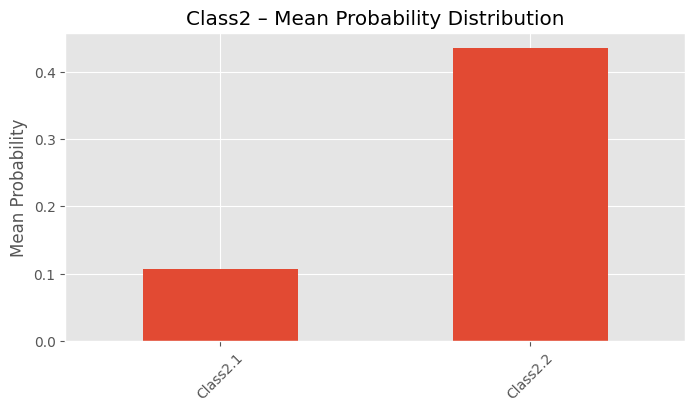

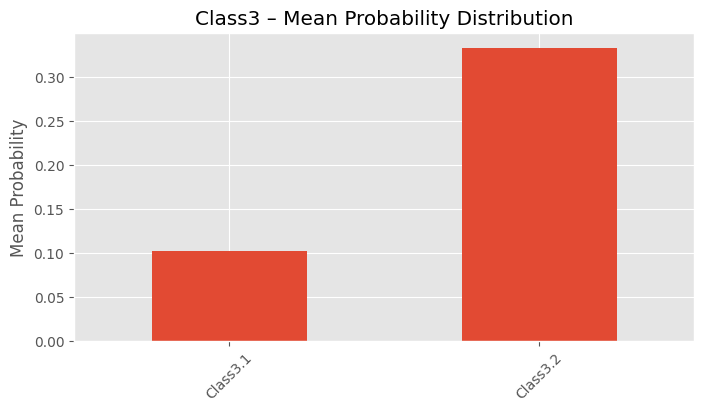

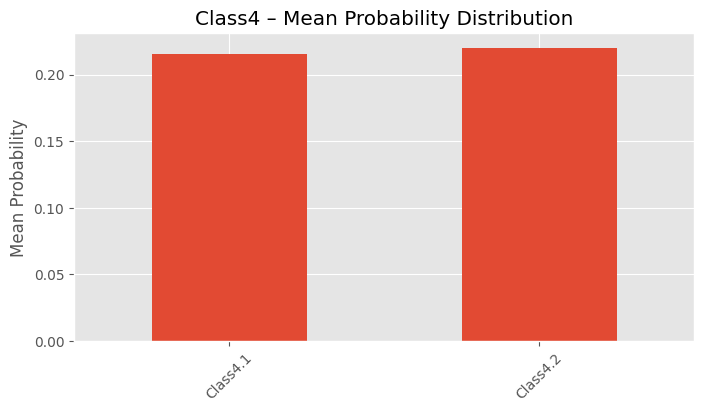

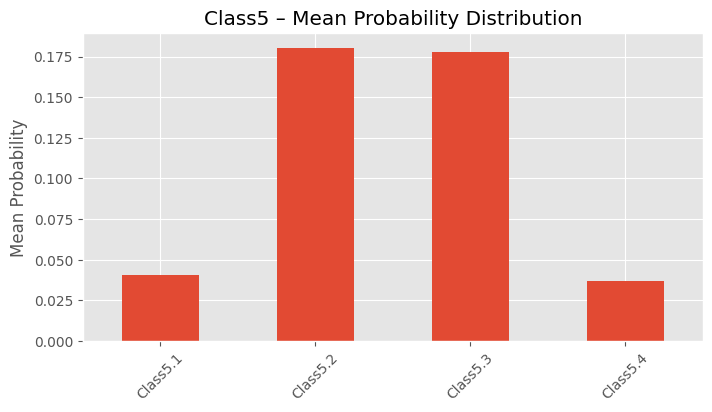

...

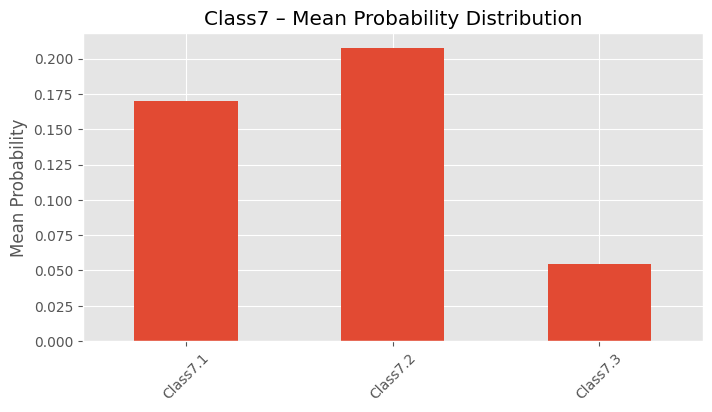

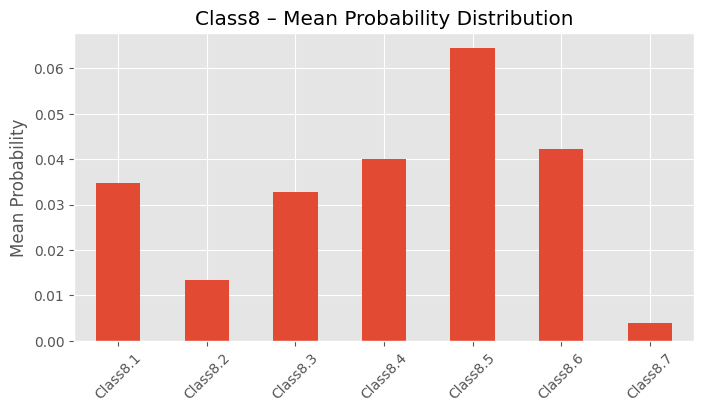

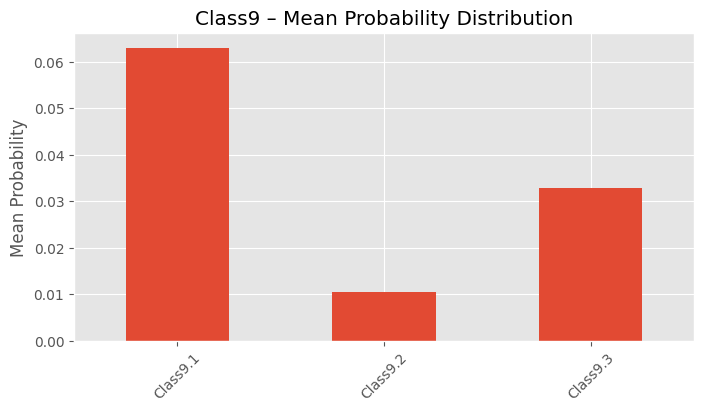

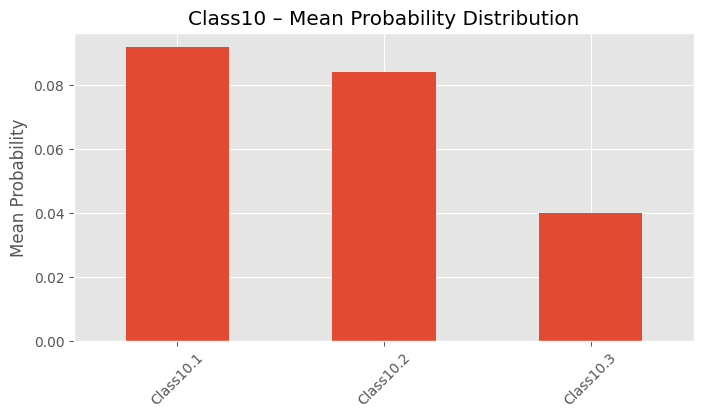

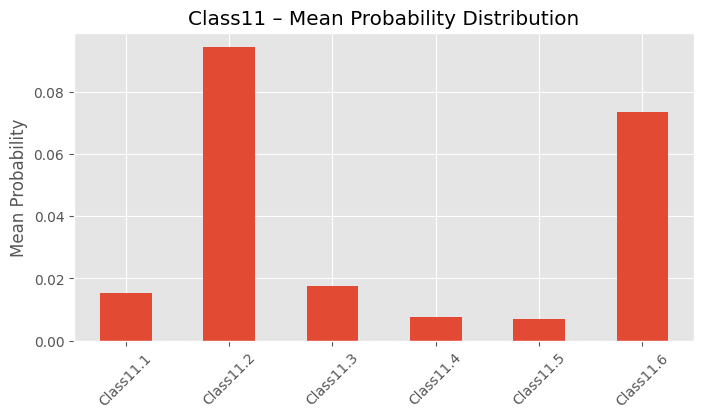

In [38]:
# Distribution of Each Class Group
for cname, cols in class_groups.items():
    plt.figure(figsize=(8,4))
    df[cols].mean().plot(kind="bar")
    plt.title(f"{cname} – Mean Probability Distribution")
    plt.ylabel("Mean Probability")
    plt.xticks(rotation=45)
    plt.show()


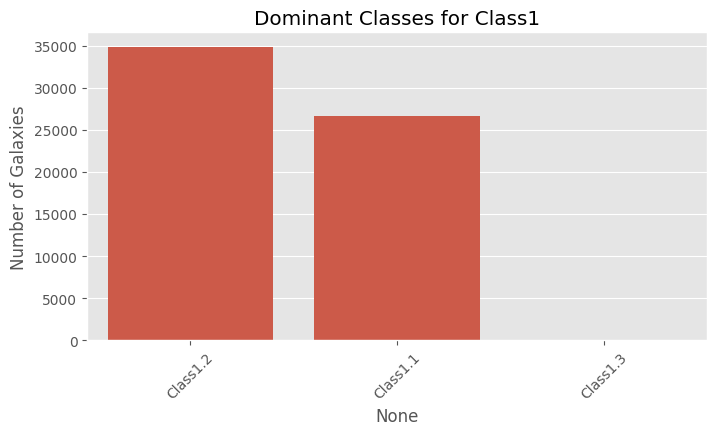

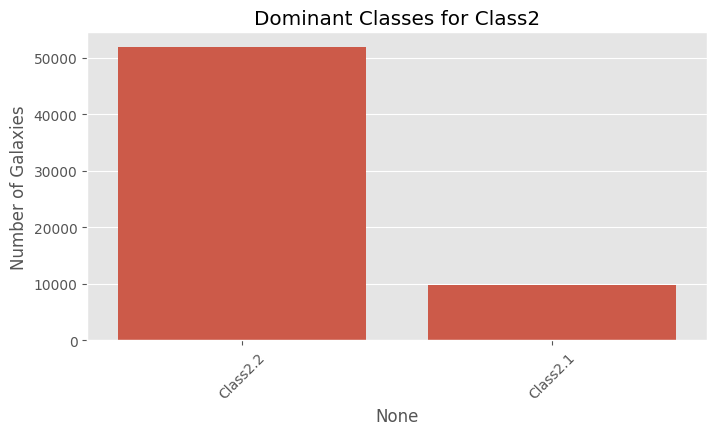

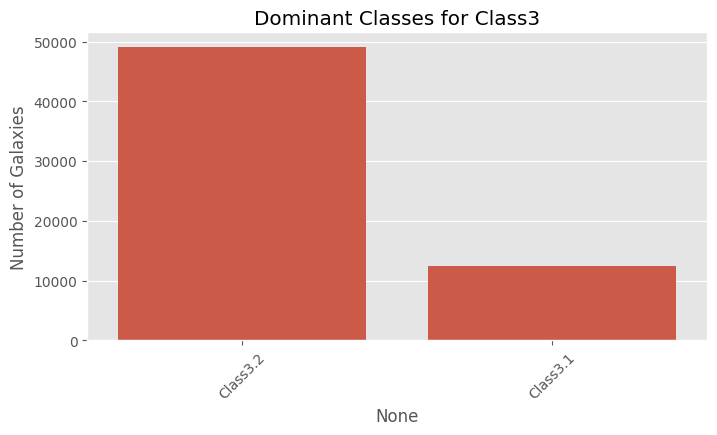

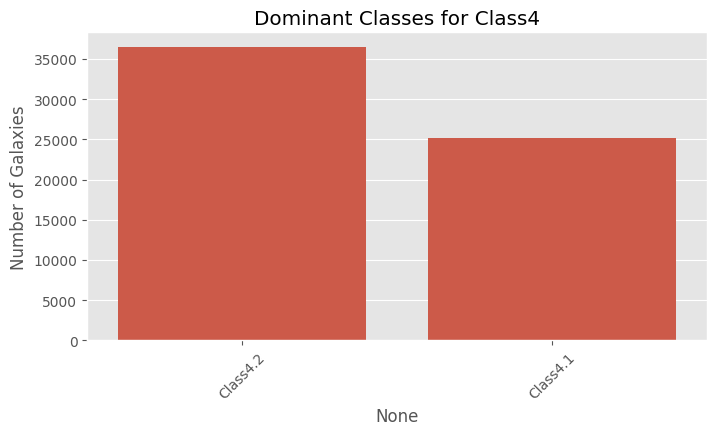

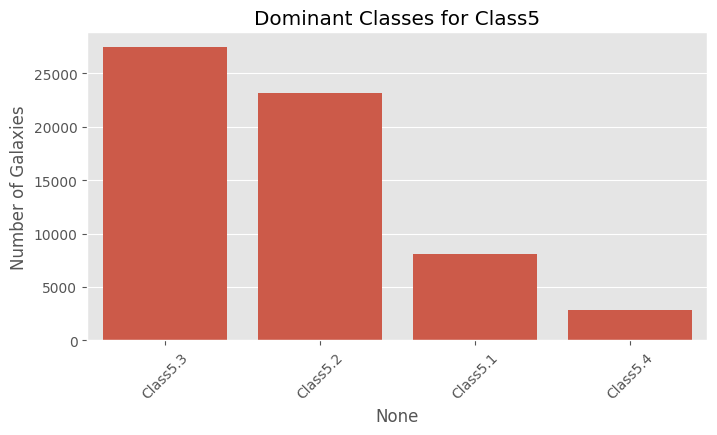

...

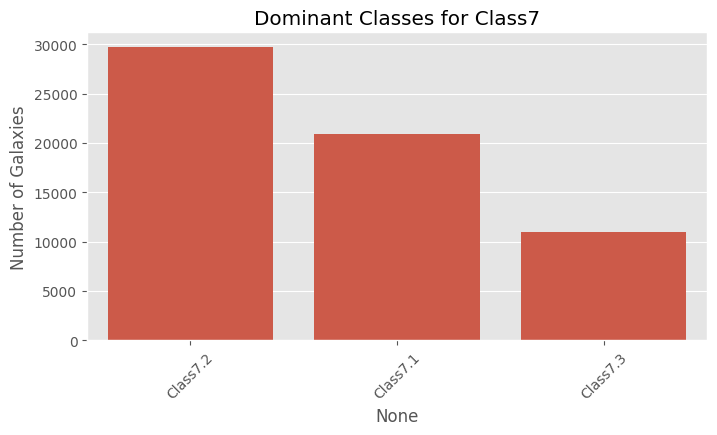

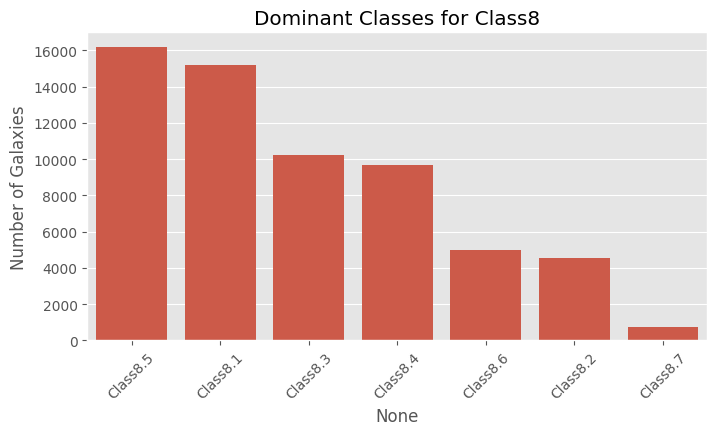

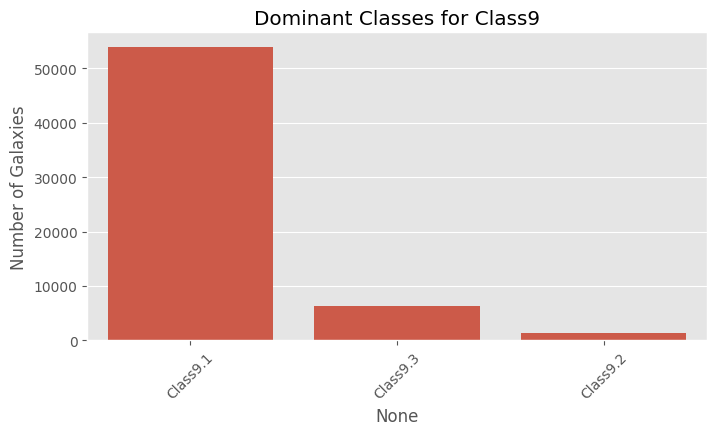

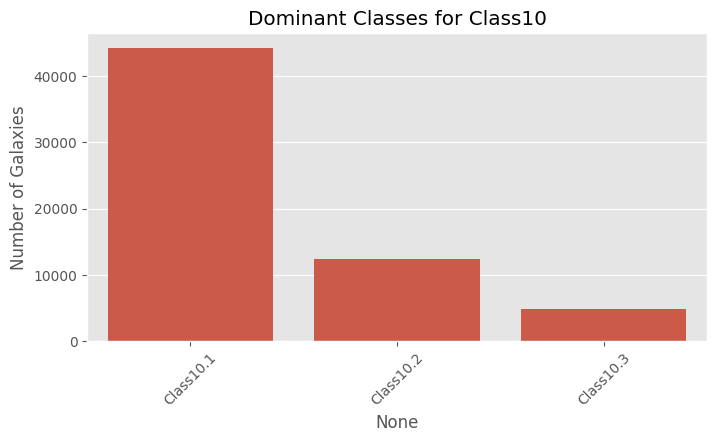

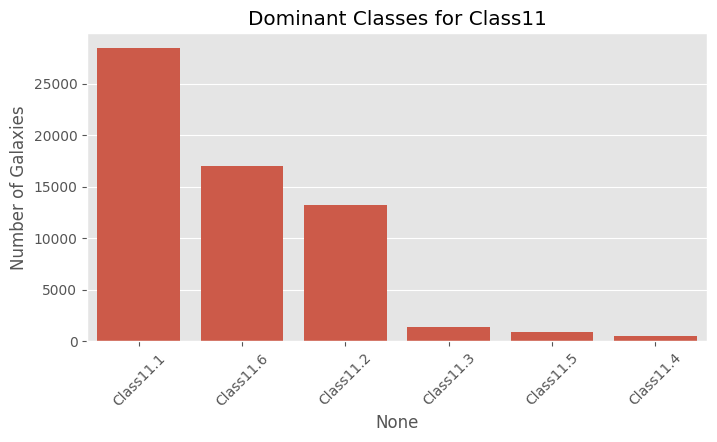

In [39]:
# Dominant Label Histograms
dominant_counts = {}

for cname, cols in class_groups.items():
    argmax_labels = df[cols].idxmax(axis=1)
    dominant_counts[cname] = argmax_labels.value_counts()

    plt.figure(figsize=(8,4))
    sns.barplot(x=dominant_counts[cname].index, y=dominant_counts[cname].values)
    plt.title(f"Dominant Classes for {cname}")
    plt.ylabel("Number of Galaxies")
    plt.xticks(rotation=45)
    plt.show()


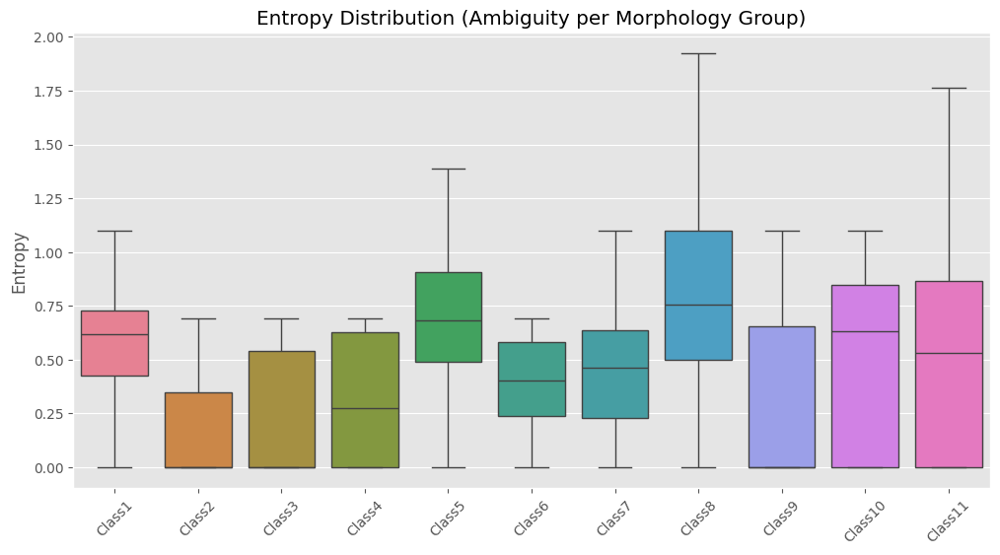

In [40]:
# Entropy: Uncertainty of Volunteers
from scipy.stats import entropy

entropy_df = pd.DataFrame()

for cname, cols in class_groups.items():
    entropy_df[cname] = df[cols].apply(lambda x: entropy(x), axis=1)

plt.figure(figsize=(12,6))
sns.boxplot(data=entropy_df)
plt.title("Entropy Distribution (Ambiguity per Morphology Group)")
plt.xticks(rotation=45)
plt.ylabel("Entropy")
plt.show()


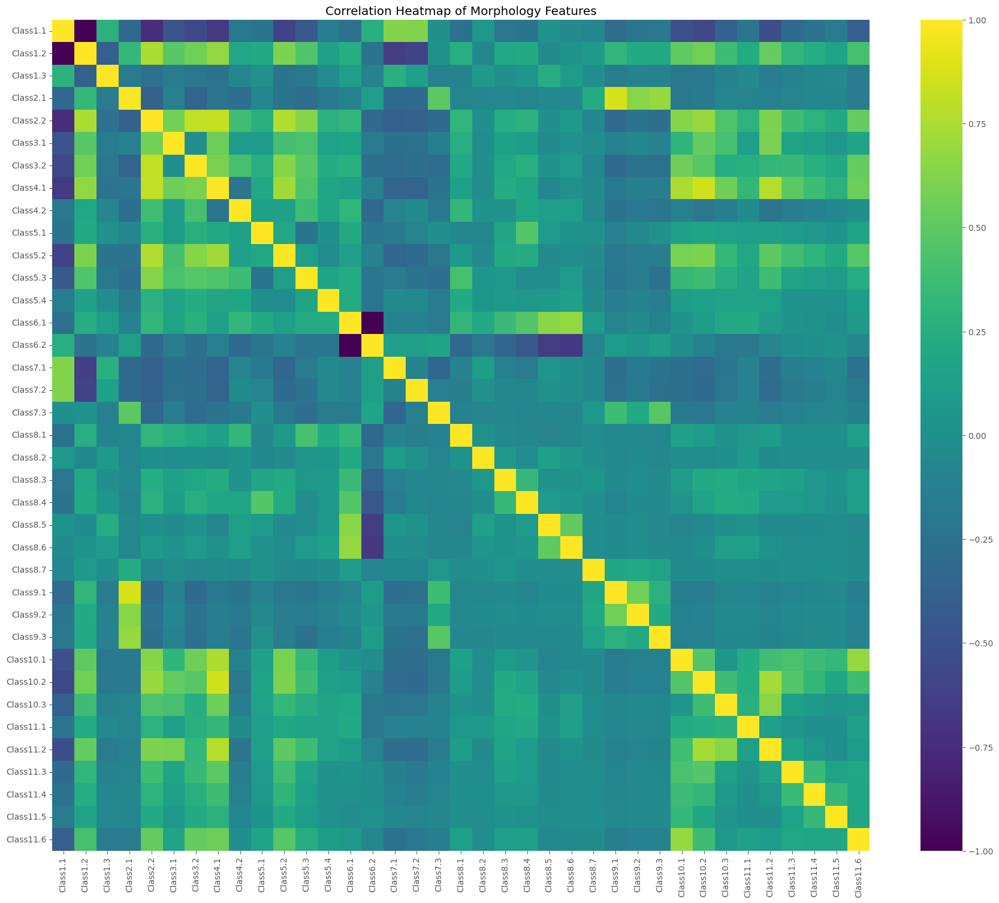

In [41]:
# Correlation Heatmap
plt.figure(figsize=(22,18))
sns.heatmap(df[[c for c in df.columns if c.startswith("Class") and c!="sum_class1"]].corr(),
            cmap="viridis")
plt.title("Correlation Heatmap of Morphology Features")
plt.show()


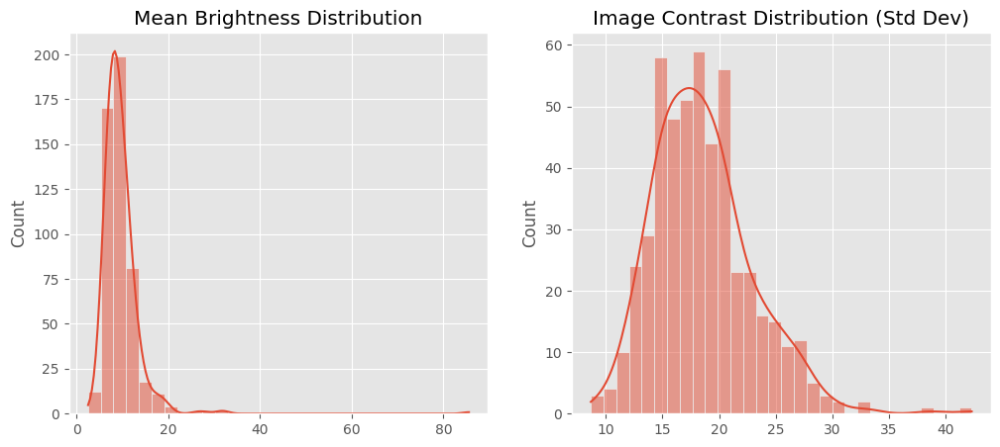

Mean brightness: 9.65237656120209
Std brightness: 4.736294139394175


In [42]:
# Image Brightness / Pixel Distribution
import numpy as np
import random
from PIL import Image

image_dir = "images_training_rev1"

brightness_means = []
brightness_stds = []

sample_files = random.sample(os.listdir(image_dir), 500)

for fname in sample_files:
    img = np.array(Image.open(os.path.join(image_dir, fname)))
    brightness_means.append(img.mean())
    brightness_stds.append(img.std())

plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(brightness_means, bins=30, kde=True)
plt.title("Mean Brightness Distribution")

plt.subplot(1,2,2)
sns.histplot(brightness_stds, bins=30, kde=True)
plt.title("Image Contrast Distribution (Std Dev)")
plt.show()

print("Mean brightness:", np.mean(brightness_means))
print("Std brightness:", np.std(brightness_means))


# Visual EDA by Morphology Class

In [43]:
# Helper Function
def show_examples(mask, title, n=9):
    ids = df[mask].sample(min(n, mask.sum())).GalaxyID.values

    plt.figure(figsize=(10,10))
    for i, gid in enumerate(ids):
        img_path = os.path.join(image_dir, f"{int(gid)}.jpg")
        img = Image.open(img_path)
        plt.subplot(3,3,i+1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(str(int(gid)))
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()


### Smooth Ellipticals

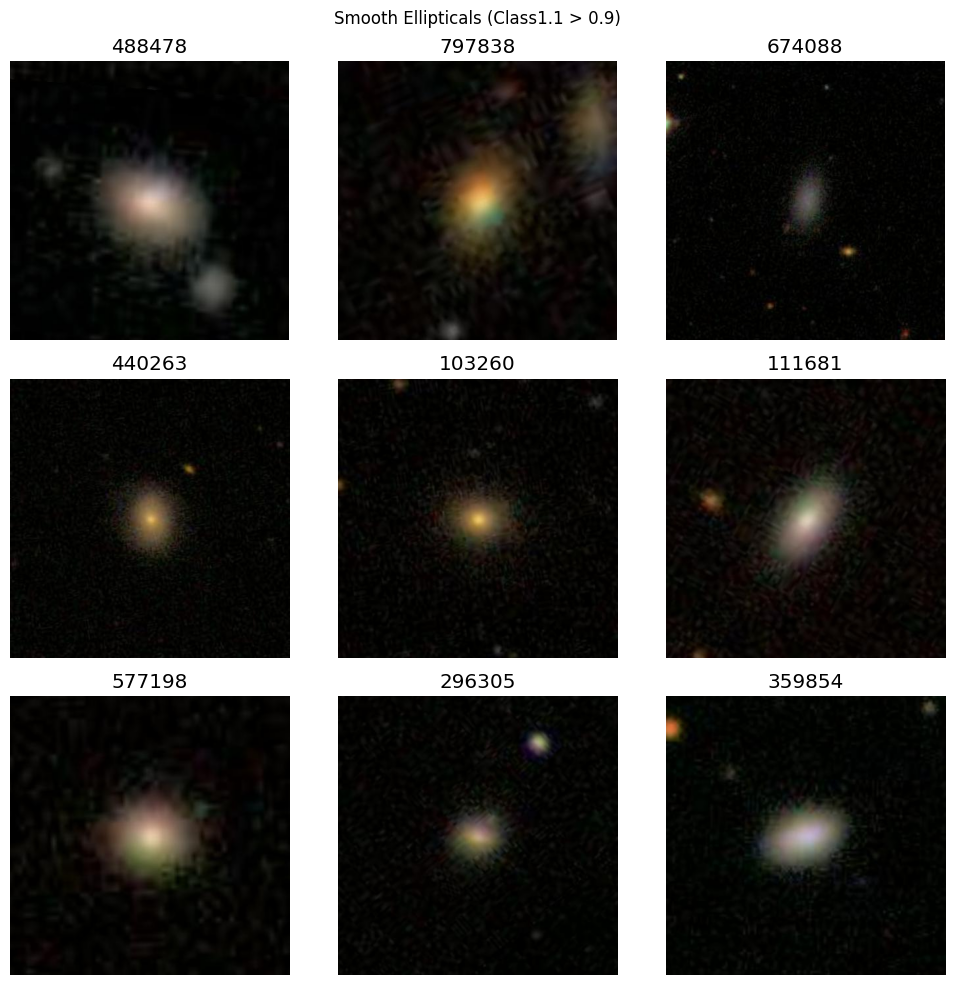

In [44]:
show_examples(df["Class1.1"]>0.9, "Smooth Ellipticals (Class1.1 > 0.9)")


### Disk / Spiral features

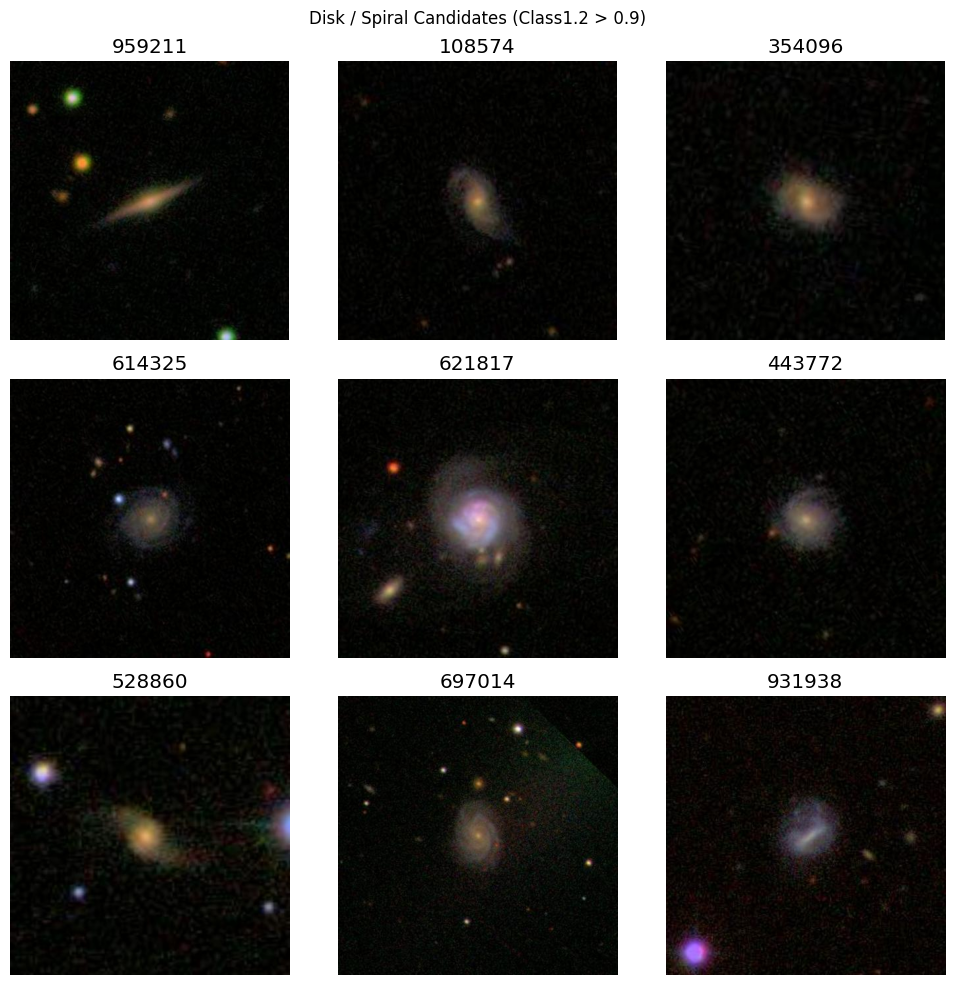

In [45]:
show_examples(df["Class1.2"]>0.9, "Disk / Spiral Candidates (Class1.2 > 0.9)")


### Artifacts / Stars

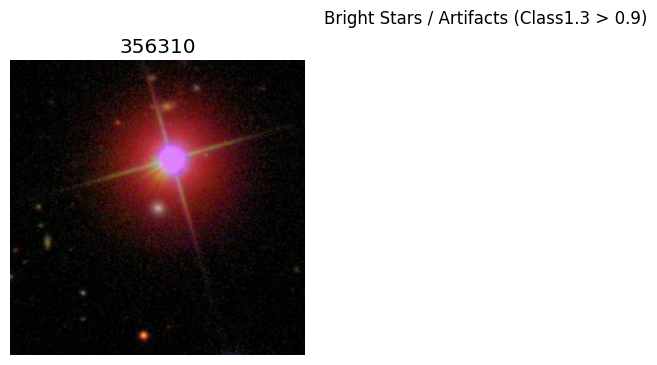

In [46]:
show_examples(df["Class1.3"]>0.9, "Bright Stars / Artifacts (Class1.3 > 0.9)")


### Edge-on Galaxies

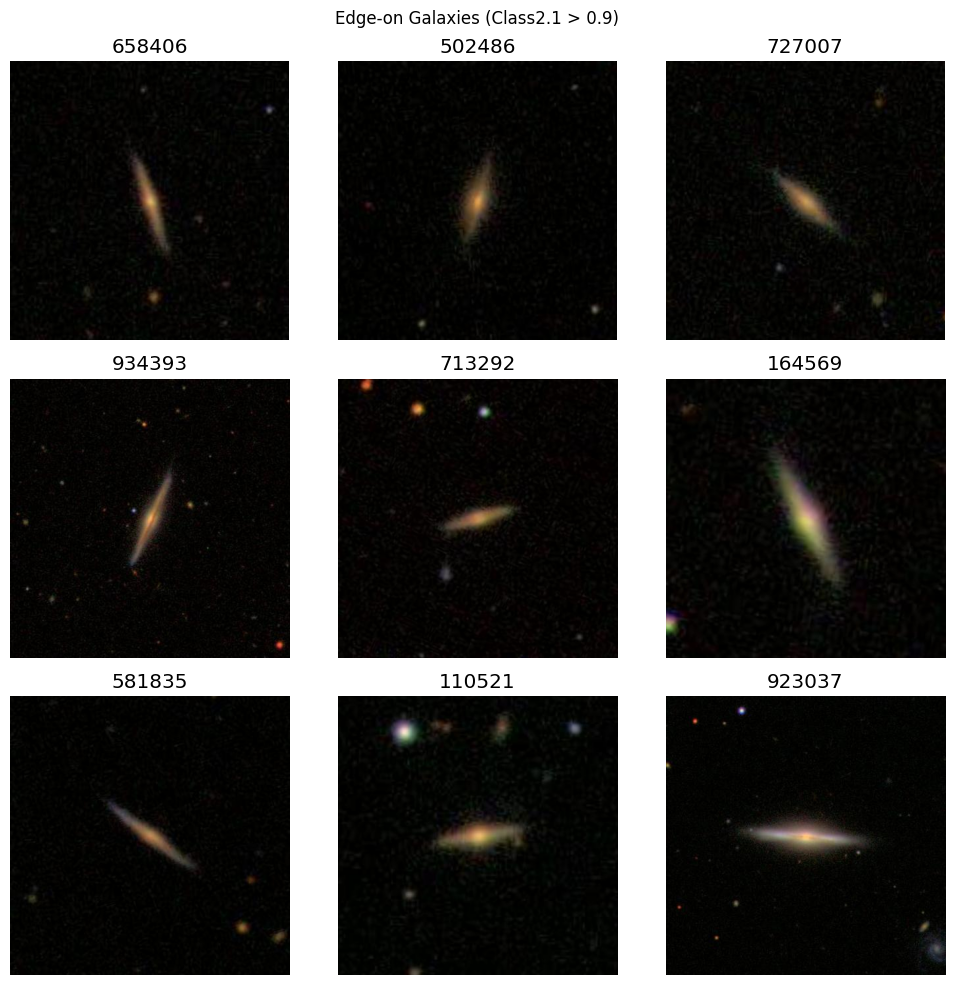

In [47]:
show_examples(df["Class2.1"]>0.9, "Edge-on Galaxies (Class2.1 > 0.9)")


# Barred Galaxies

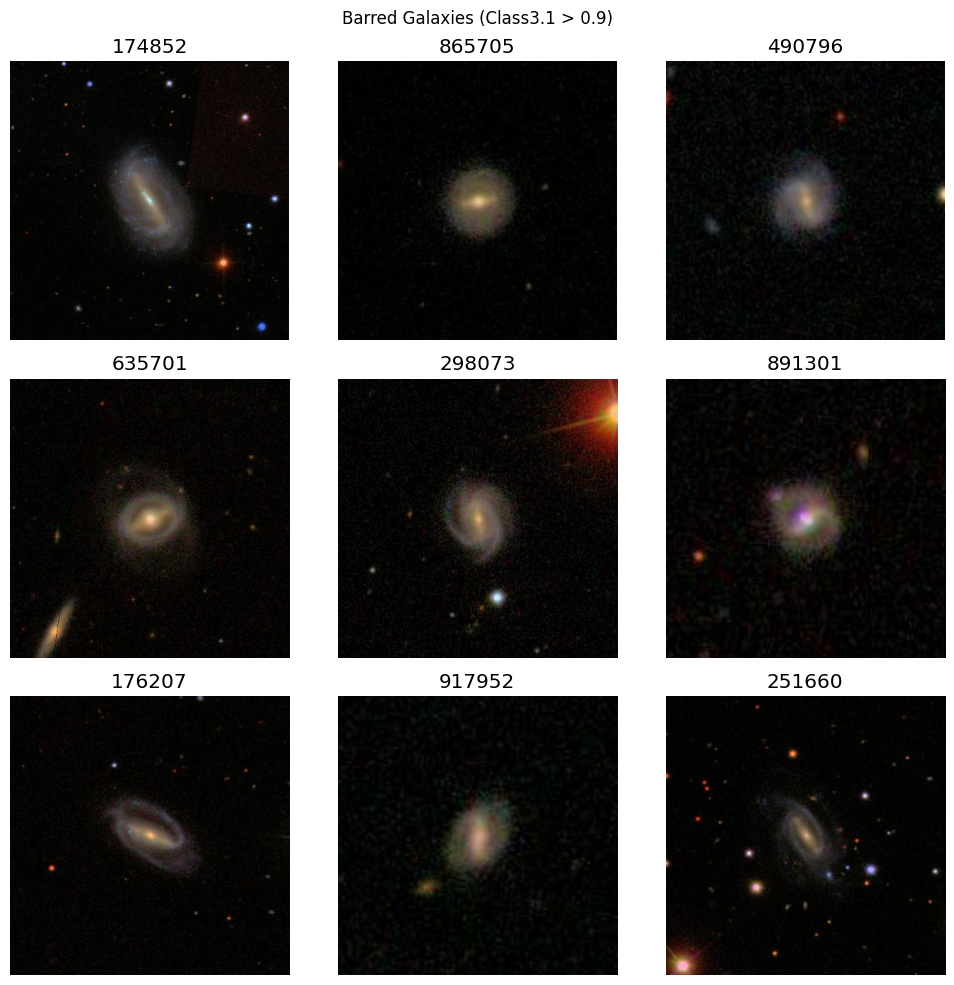

In [48]:
show_examples(df["Class3.1"]>0.9, "Barred Galaxies (Class3.1 > 0.9)")


### Spiral Galaxies

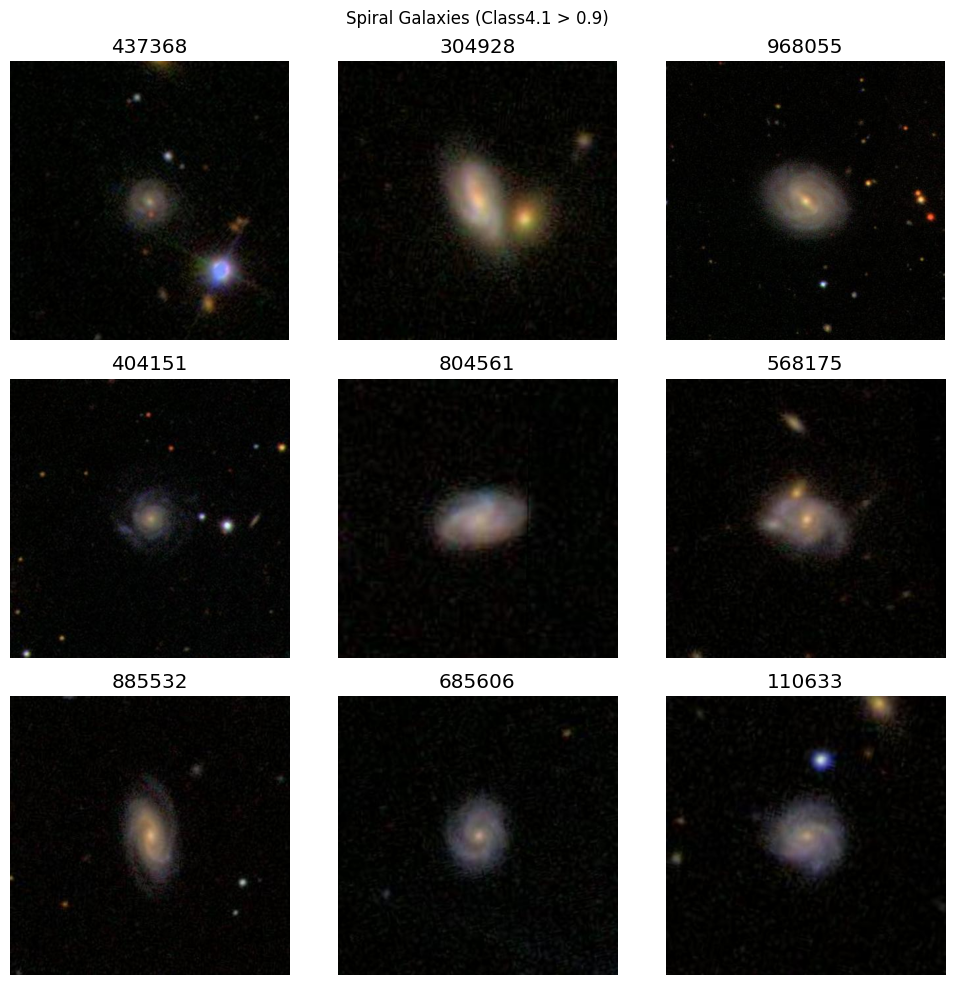

In [ ]:
show_examples(df["Class4.1"]>0.9, "Spiral Galaxies (Class4.1 > 0.9)")


### Bulge Prominence

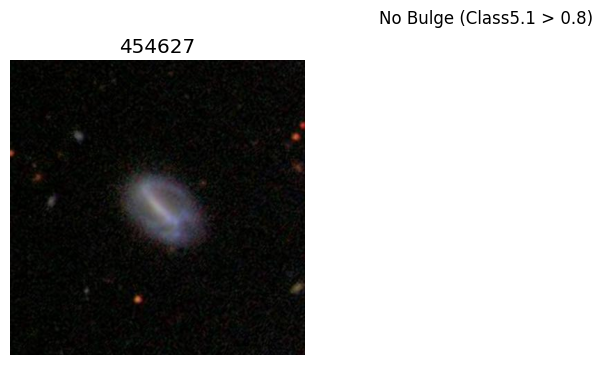

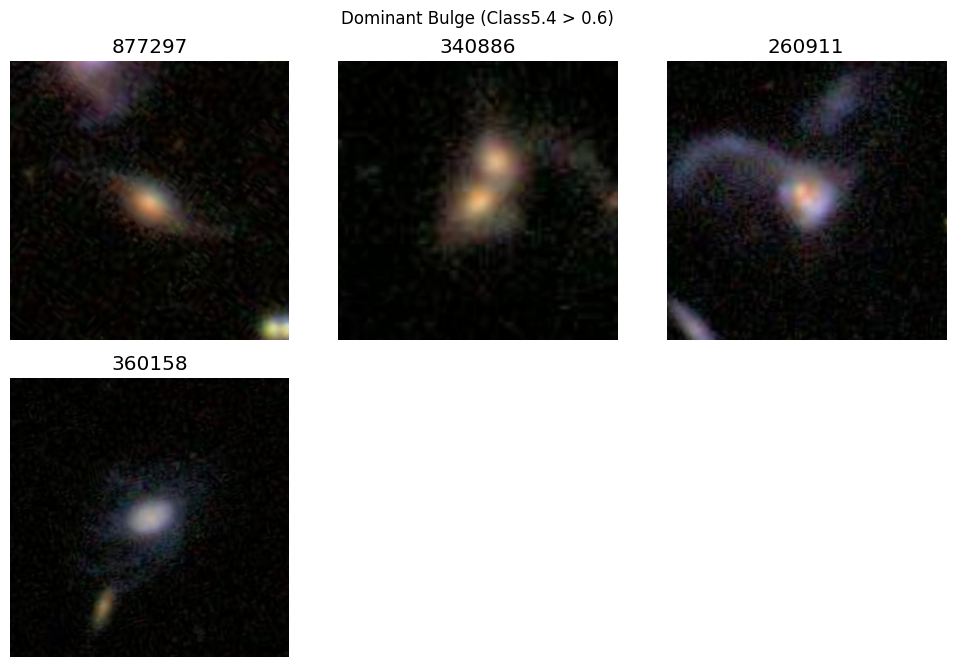

In [53]:
show_examples(df["Class5.1"]>0.8, "No Bulge (Class5.1 > 0.8)")
show_examples(df["Class5.4"]>0.6, "Dominant Bulge (Class5.4 > 0.6)")


### Rings

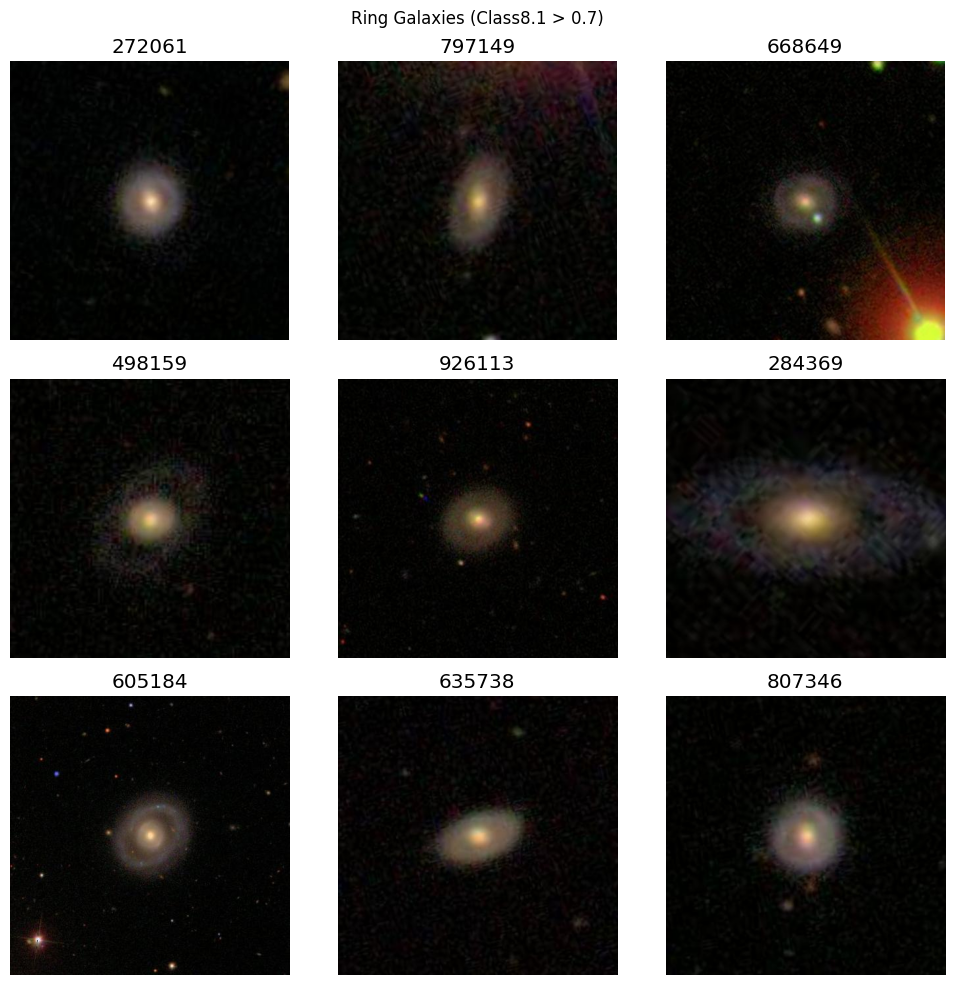

In [54]:
show_examples(df["Class8.1"]>0.7, "Ring Galaxies (Class8.1 > 0.7)")


### Irregular / Disturbed

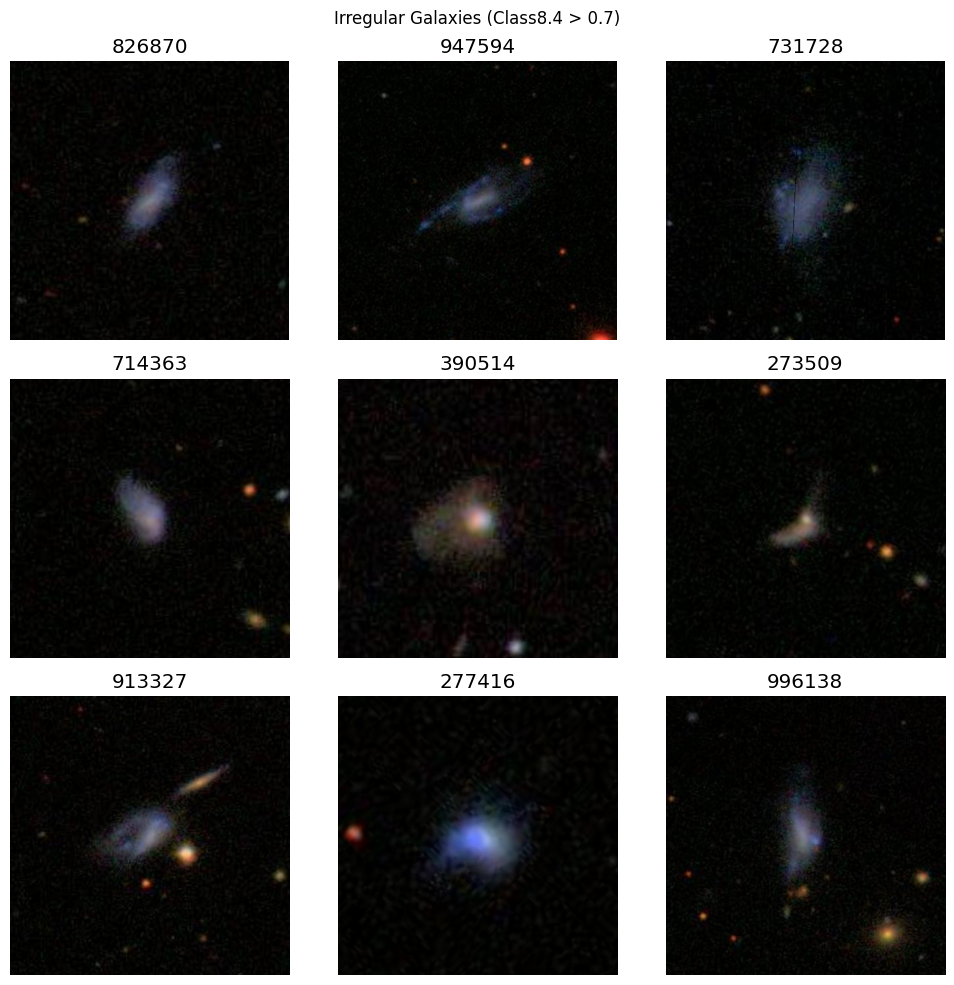

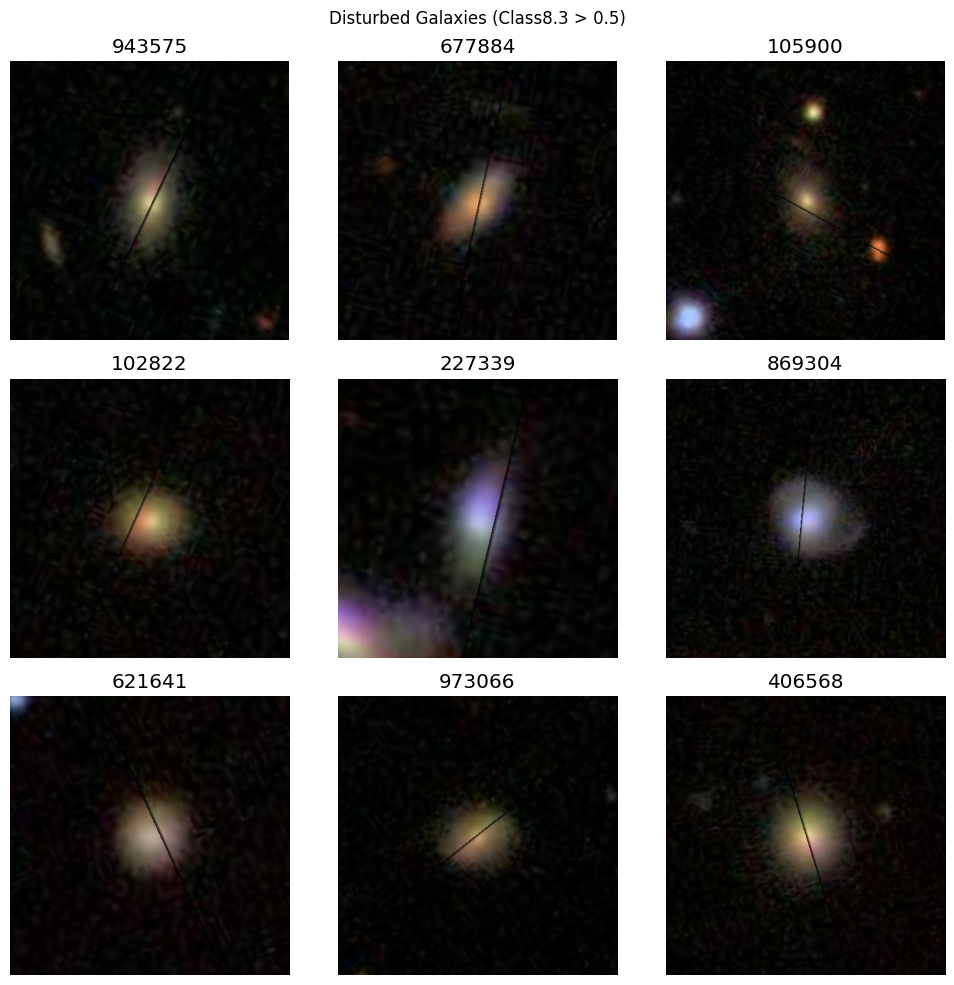

In [57]:
show_examples(df["Class8.4"]>0.7, "Irregular Galaxies (Class8.4 > 0.7)")
show_examples(df["Class8.3"]>0.5, "Disturbed Galaxies (Class8.3 > 0.5)")


### Mergers

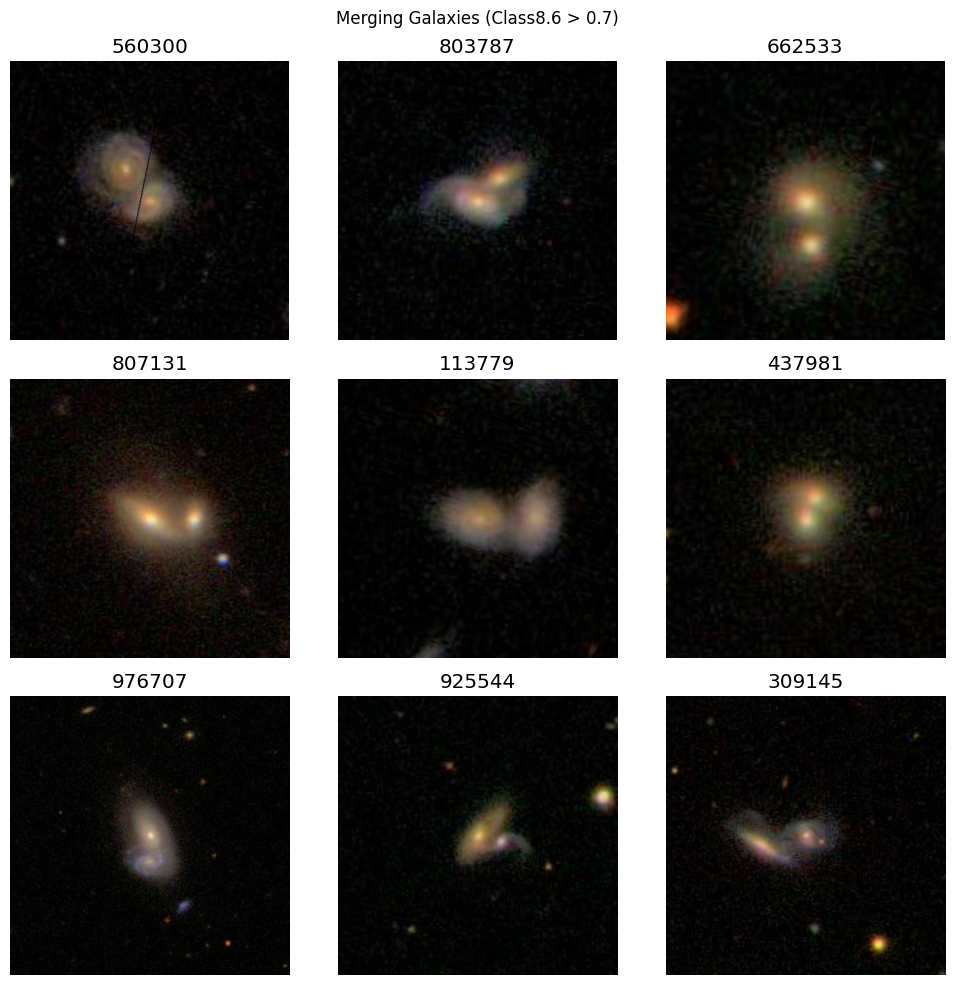

In [58]:
show_examples(df["Class8.6"]>0.7, "Merging Galaxies (Class8.6 > 0.7)")


### Dust Lanes

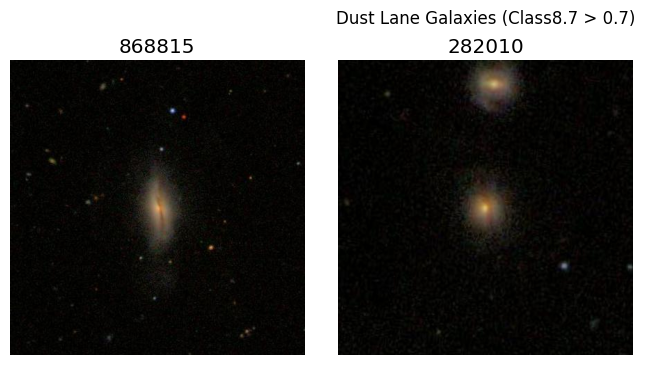

In [59]:
show_examples(df["Class8.7"]>0.7, "Dust Lane Galaxies (Class8.7 > 0.7)")


### Spiral Tightness

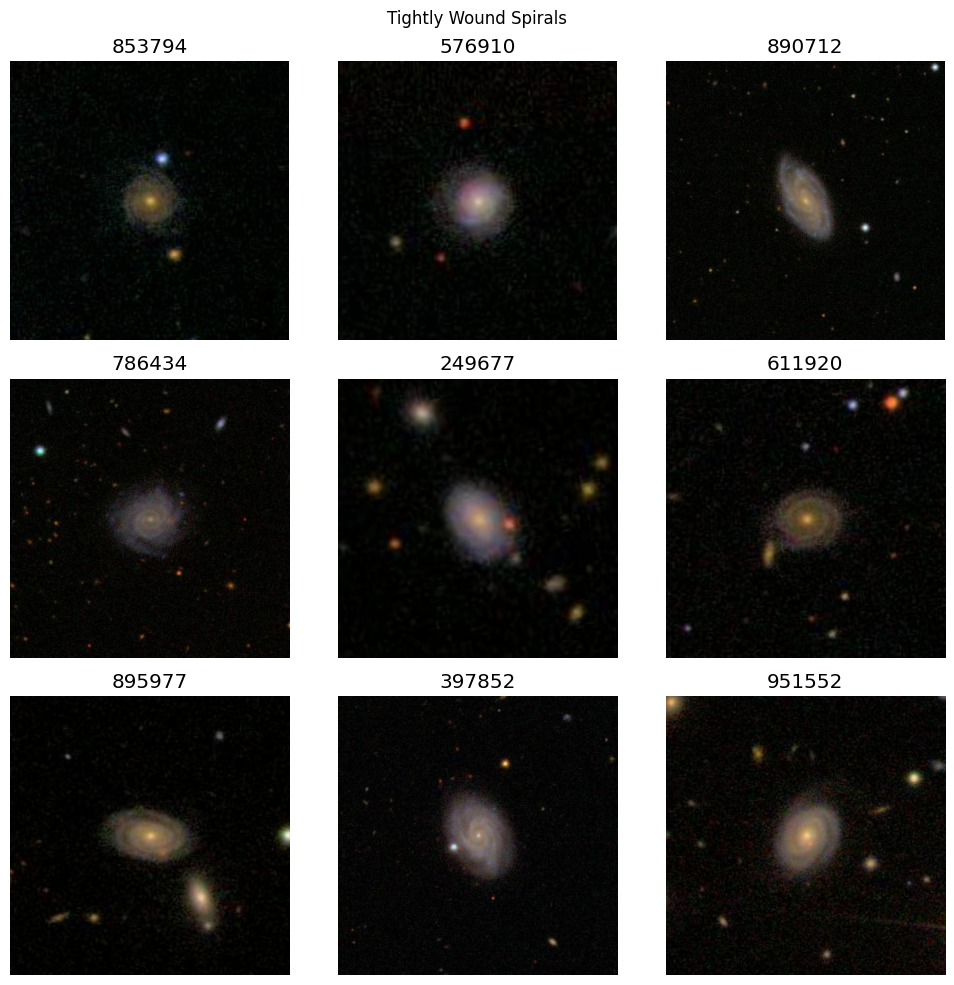

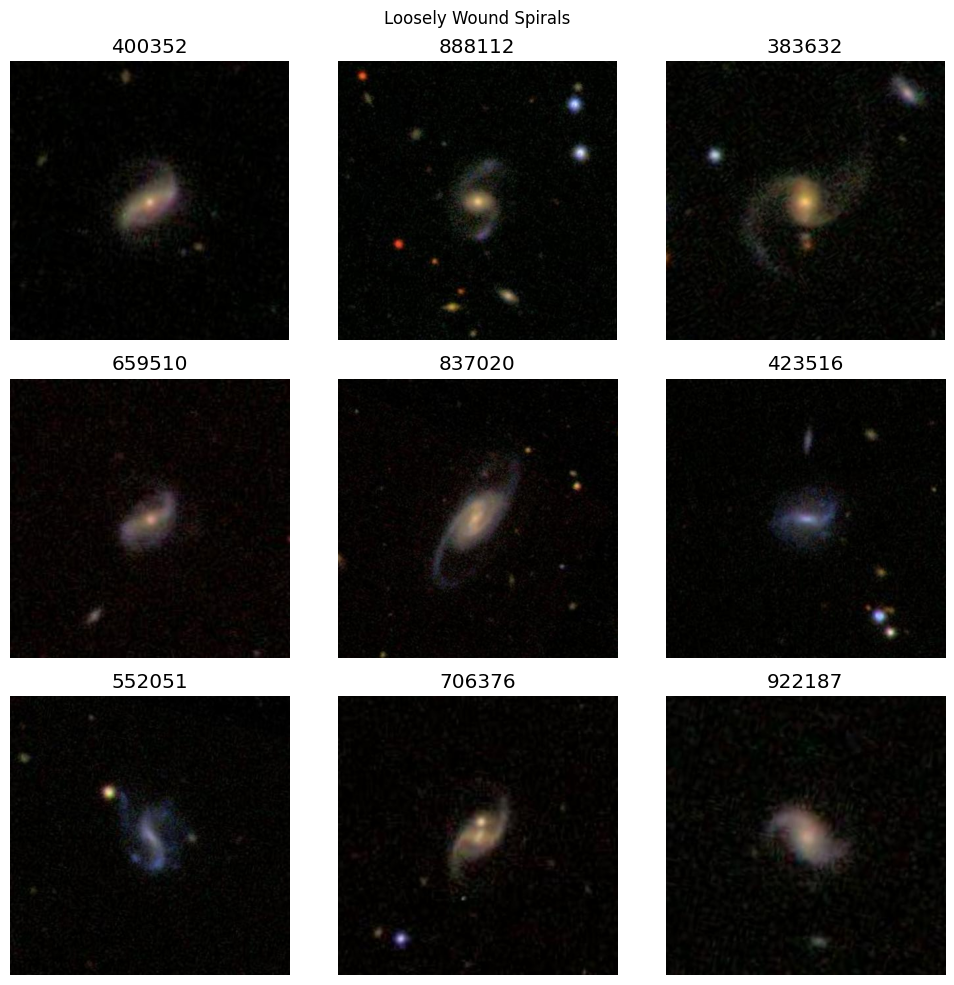

In [60]:
show_examples(df["Class10.1"]>0.7, "Tightly Wound Spirals")
show_examples(df["Class10.3"]>0.7, "Loosely Wound Spirals")


### Number of Spiral Arms

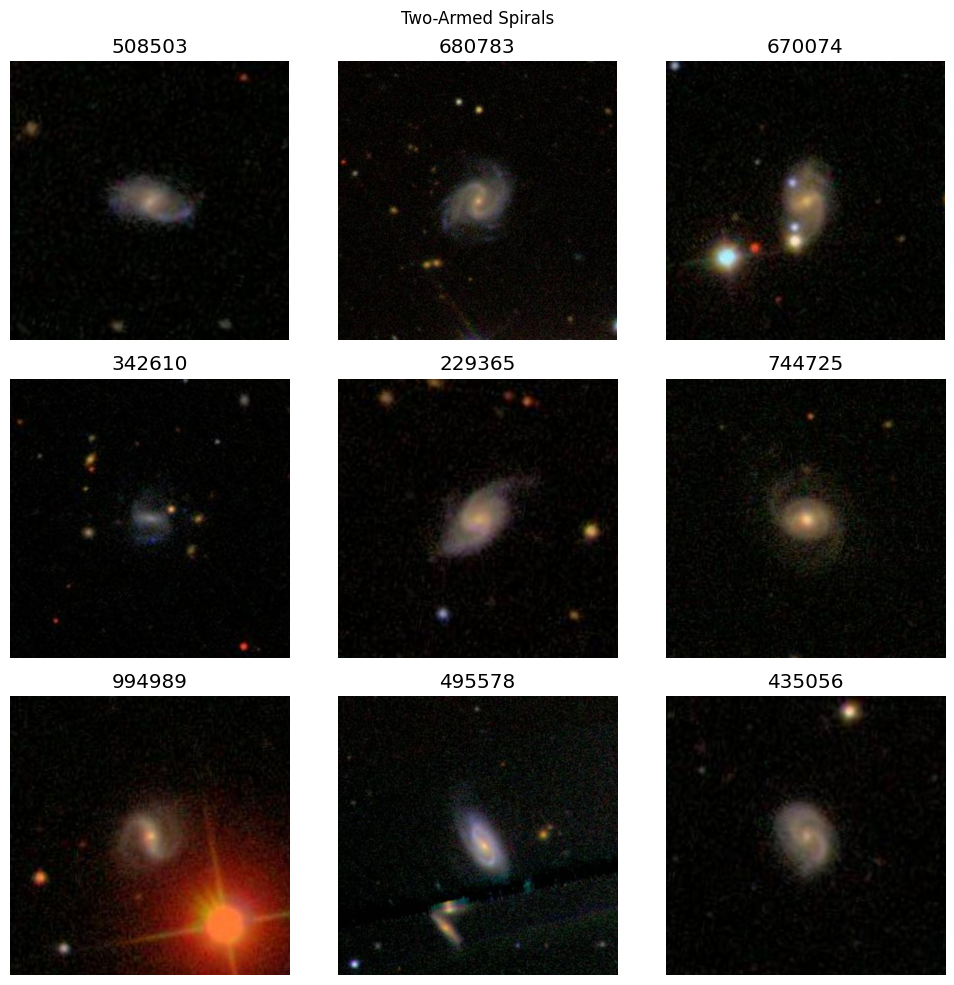

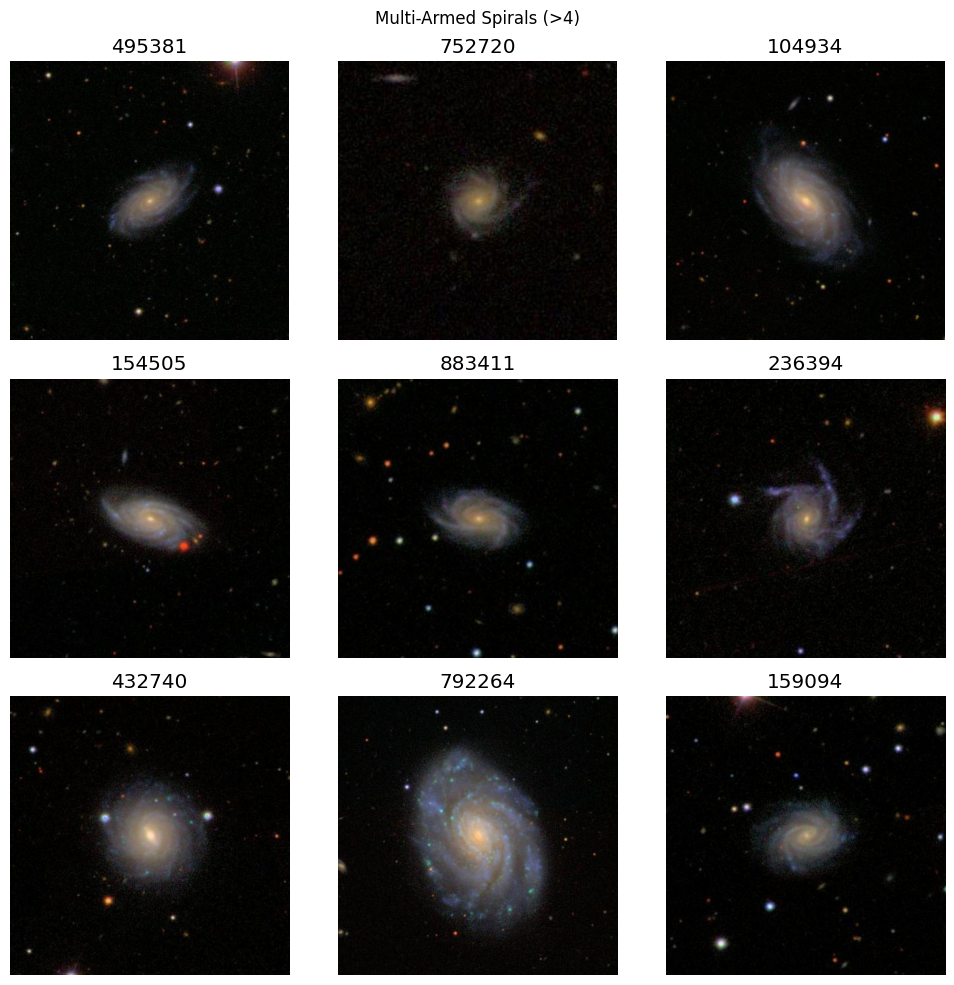

In [61]:
show_examples(df["Class11.2"]>0.7, "Two-Armed Spirals")
show_examples(df["Class11.5"]>0.7, "Multi-Armed Spirals (>4)")


# Ambiguity / Label-Noise EDA

### High entropy galaxies (hard cases)

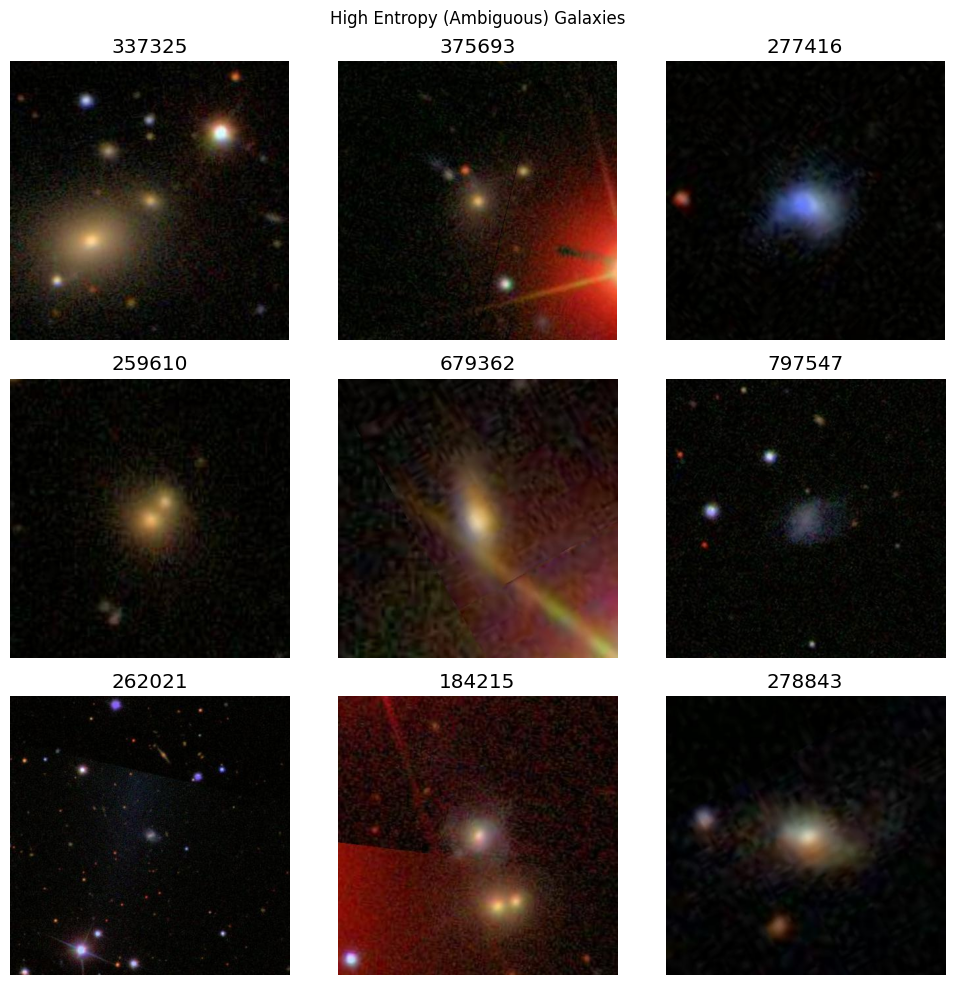

In [63]:
df['entropy'] = df[class_groups["Class1"]].apply(lambda x: entropy(x),axis=1)

show_examples(df['entropy']>1.0, "High Entropy (Ambiguous) Galaxies")
